## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [ ]:
%%time
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib qt
nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
no_img=0
img_size = 0
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(500)
        no_img += 1
        img_size = (gray.shape[1], gray.shape[0])
cv2.destroyAllWindows()
print("no of image processed successfully:", no_img)
print("Image processed Size:", img_size)


In [ ]:
import pickle

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
dist_pickle["rvecs"] = rvecs
dist_pickle["tvecs"] = tvecs
pickle.dump( dist_pickle, open( "Project_cam_dist_pickle.p", "wb" ) )

In [ ]:
%matplotlib inline
# Test undistortion on an image
img = cv2.imread('camera_cal/calibration1.jpg')


dst = cv2.undistort(img, mtx, dist, None, mtx)
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

cv2.imwrite('calibration1_undistorted.jpg',dst)

In [1]:
import pickle
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Read in the saved camera matrix and distortion coefficients
# These are the arrays you calculated using cv2.calibrateCamera()
dist_pickle = pickle.load( open( "Project_cam_dist_pickle.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
images = glob.glob('test_images/*.jpg')
# Read in an image

nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y

In [2]:
print(images)
print("camera matrix:", mtx)
print("distortion: ",dist)


['test_images\\straight_lines1.jpg', 'test_images\\straight_lines2.jpg', 'test_images\\test1.jpg', 'test_images\\test2.jpg', 'test_images\\test3.jpg', 'test_images\\test4.jpg', 'test_images\\test5.jpg', 'test_images\\test6.jpg']
camera matrix: [[1.15396093e+03 0.00000000e+00 6.69705359e+02]
 [0.00000000e+00 1.14802495e+03 3.85656232e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
distortion:  [[-2.41017968e-01 -5.30720497e-02 -1.15810318e-03 -1.28318543e-04
   2.67124302e-02]]


### Distortion correction

In [3]:
def un_distort(img):
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    return dst

In [ ]:
# i = 7
# fig, axs = plt.subplots(1, 2, figsize=(14, 7))
# axs = axs.ravel()

# img = cv2.imread(images[i])
# un_dst = un_distort(img)
# axs[0].imshow(np.flip(img,2))
# axs[1].imshow(np.flip(un_dst,2))

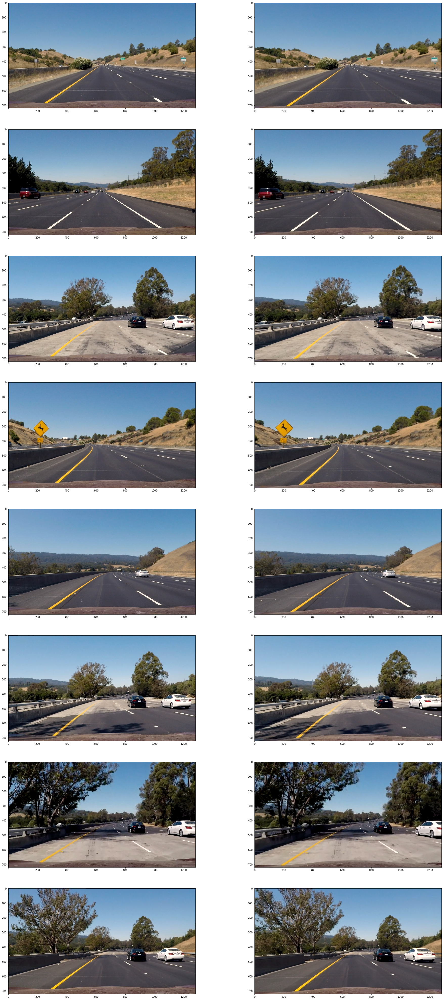

In [7]:
no_test_imgs = len(images)
fig, axs = plt.subplots(no_test_imgs, 2, figsize=(16*2, 9*no_test_imgs))
un_dst_img=[]
axs = axs.ravel()
for i in range(no_test_imgs):
    img = cv2.imread(images[i])
    un_dst_img.append(un_distort(img))
    axs[i*2].imshow(np.flip(img,2))
    axs[i*2+1].imshow(np.flip(un_dst_img[i],2))

In [5]:
fig.savefig('un_distort.jpg', dpi=100)

### Color and Gradient

In [8]:
def detect_color_gradient(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hls[:,:,2]
    s_channel = hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # plt.hist(s_channel)
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    # color_binary = np.uint8(np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255)
    color_binary = np.uint8(np.dstack(( np.zeros_like(sxbinary), sxbinary, np.zeros_like(sxbinary))) * 255)

    binary_img = np.zeros_like(s_channel)
    binary_img[(s_channel ==1) | (sxbinary ==1)] = 1
    binary_img = np.uint8(binary_img* 255)
#     color_binary = np.uint8(np.dstack(( binary_img, binary_img, binary_img)) * 255)
#     binary_img = np.bitwise_or(sxbinary, s_binary)
    return binary_img
#     return color_binary

# i = 0
# fig, axs = plt.subplots(1, 2, figsize=(14, 7))
# axs = axs.ravel()

# # img = cv2.imread(images[i])
# # gradient_img = detect_color_gradient(img)
# gradient_img = detect_color_gradient(un_dst)
# axs[i*2].imshow(np.flip(img,2))
# axs[i*2+1].imshow(gradient_img)


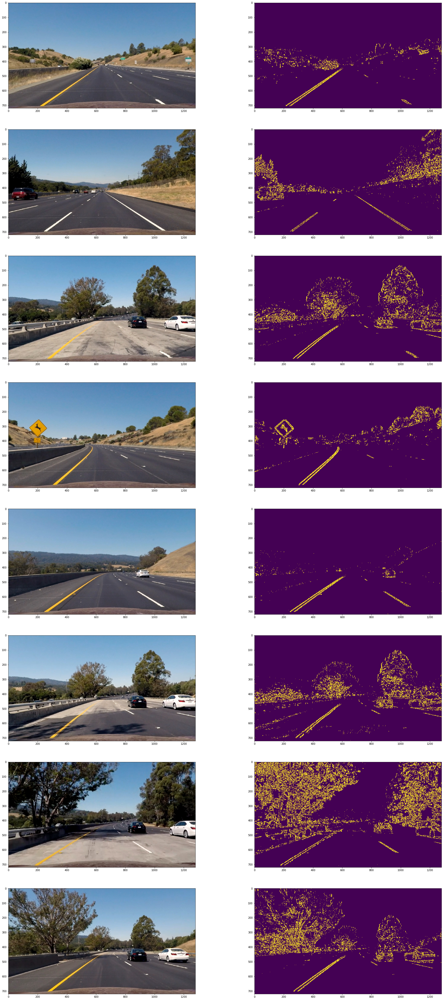

In [9]:
## plot gradient test images
fig, axs = plt.subplots(no_test_imgs, 2, figsize=(16*2, 9*no_test_imgs))
gradient_img=[]
axs = axs.ravel()
for i in range(no_test_imgs):
#     img = cv2.imread(images[i])
    gradient_img.append(detect_color_gradient(un_dst_img[i]))
    axs[i*2].imshow(np.flip(un_dst_img[i],2))
    axs[i*2+1].imshow(gradient_img[i])

### Prespective Transform

In [10]:
src1 = np.float32([ [580, 460 ], [180, 720 ], [1220, 720], [730, 460 ]])
dst1 = np.float32( [[320, 0 ], [320, 720 ], [960, 720], [960, 0 ]])

def prespective_transform(img, src=src1, dst=dst1):
    
    # cv2.getPerspectiveTransform() to get M, Minv the transform matrix
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    # cv2.warpPerspective() to warp your image to a top-down view
    # print(img.shape[1::-1])
    warped = cv2.warpPerspective(img, M, (960, 720), flags=cv2.INTER_LINEAR)

    return warped, M, Minv
    

In [ ]:
# i = 0

# fig, axs = plt.subplots(1, 2, figsize=(14, 7))
# axs = axs.ravel()

# # img = cv2.imread(images[i])
# # gradient_img = detect_color_gradient(img)

# src = np.float32([ [580, 460 ], [180, 720 ], [1220, 720], [730, 460 ]])
# dst = np.float32( [[320, 0 ], [320, 720 ], [960, 720], [960, 0 ]])
# warped_img, M, Minv = prespective_transform(gradient_img, src, dst)
 
# axs[i*2].imshow(gradient_img)

# axs[i*2+1].imshow(warped_img)

# print(warped_img.shape)    

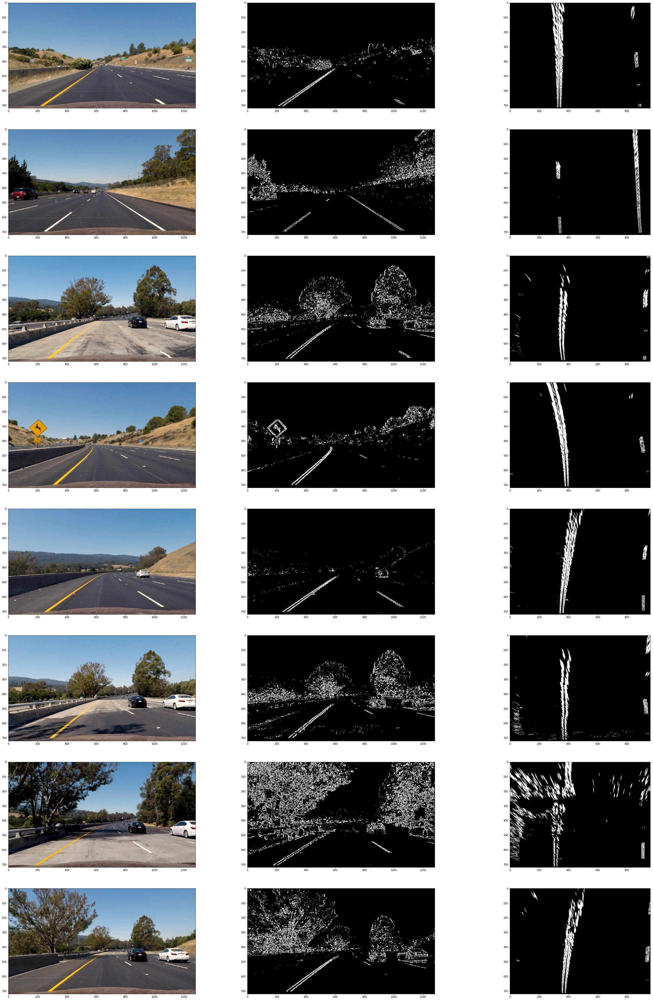

In [13]:
# plot prespective transform
fig, axs = plt.subplots(no_test_imgs, 3, figsize=(16*3, 9*no_test_imgs))
warped_img=[]
M =[] 
Minv =[]
axs = axs.ravel()
for i in range(no_test_imgs):
#     img = cv2.imread(images[i])
    wp_img, M, Minv = prespective_transform(gradient_img[i])
    warped_img.append(wp_img)
    axs[i*3].imshow(np.flip(un_dst_img[i],2))
    axs[i*3+1].imshow(gradient_img[i], cmap = 'gray')
    axs[i*3+2].imshow(warped_img[i], cmap = 'gray')

In [39]:
def detect_lane(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[np.int(binary_warped.shape[0]/2):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # out_img =binary_warped
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint


    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high), (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & \
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & \
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # getting center of lanes 
    lane_center = (left_fitx[-1]+ left_fitx[-1])/2
    
    ### visvulatization for debugging

#     out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
#     out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
#     plt.imshow(out_img)
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')
#     plt.xlim(0, 1280)
#     plt.ylim(720, 0)

    # Define y-value where we want radius of curvature
    y_eval = np.max(ploty)
#     left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
#     right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
#     print(left_curverad, right_curverad)
    
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
#     left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
#     right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)

    # using initial pointed on the image
#     left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
#     right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
#     print(left_curverad, 'm', right_curverad, 'm')
    avg_curverad = (left_curverad + right_curverad)/2
    print("Average: ",avg_curverad, 'm')
    

    
    return ploty, left_fitx, right_fitx, avg_curverad, lane_center

In [40]:
##calling function
ploty, left_fitx, right_fitx, avg_curverad, lane_center = detect_lane(warped_img[i])

Average:  31608.11401955583 m


In [41]:
def draw_lanes(undist, warped, ploty, left_fitx, right_fitx):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undist.shape[1], undist.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    return result


# plt.imshow(draw_lanes(np.flip(un_dst,2), warped_img, ploty, left_fitx, right_fitx))    
    

In [42]:
def pipeline_image_processing(img): 
    imshape = img.shape 
    undistort_img = un_distort(img)
    binary_img1 = detect_color_gradient(undistort_img, s_thresh=(170, 255), sx_thresh=(20, 100))
    
#     src = np.float32([ [585, 460 ], [203, 720 ], [1127, 720], [695, 460 ]])
#     dst  =np.float32( [[320, 0 ], [320, 720 ], [960, 720], [960, 0 ]])
    
    src = np.float32([ [580, 460 ], [180, 720 ], [1220, 720], [730, 460 ]])
    dst  =np.float32( [[320, 0 ], [320, 720 ], [960, 720], [960, 0 ]])
    warped_img, M, Minv = prespective_transform(binary_img1, src, dst)
    ploty, left_fitx, right_fitx, avg_curverad, lane_center = detect_lane(warped_img)
    result = draw_lanes(undistort_img, warped_img,ploty, left_fitx, right_fitx)
    
    #calculated position of vehicle
    vehicle_position = (imshape[1]- (src[1][0]+lane_center))*(3.7/700)
        
        
    # Overlay pipline stages
    overlay_col_size = int(imshape[1]/4)
    overlay_row_size = int(imshape[0]/4)
    # resizing to fit smaller window
    undistort_img_resized = cv2.resize(undistort_img, (overlay_col_size, overlay_row_size ))
    binary_img1_resized = cv2.resize(binary_img1, (overlay_col_size, overlay_row_size ))
    warped_img_resized = cv2.resize(warped_img, (overlay_col_size, overlay_row_size ))
    
    # adding Undistorted to final output, with image label
    cv2.putText(result, "Undistorted image", (25, 20),\
                    cv2.FONT_HERSHEY_PLAIN, 1.1, (255, 255, 0), 1)
    result[30:overlay_row_size + 30, 10:overlay_col_size +10 ]  \
    = undistort_img_resized          
    
    
    # adding Gradient to final output, with image label
    cv2.putText(result, "Gradient", (overlay_col_size + 35, 20),\
                cv2.FONT_HERSHEY_PLAIN, 1.1, (255, 255, 0), 1)
    result[30:overlay_row_size + 30,  overlay_col_size + 20: 2*overlay_col_size +20 ]  \
    = cv2.cvtColor(binary_img1_resized, cv2.COLOR_GRAY2RGB)


    # adding Warped to final output, with image label
    cv2.putText(result, "Warped image", (2*overlay_col_size +45, 20),\
            cv2.FONT_HERSHEY_PLAIN, 1.1, (255, 255, 0), 1)
    result[30:overlay_row_size + 30, 2*overlay_col_size +30: 3*overlay_col_size +30 ]  \
    = cv2.cvtColor(warped_img_resized, cv2.COLOR_GRAY2RGB)
    
    
    cv2.putText(result, "Radius of curvature: {0:.0f} m".format(avg_curverad), (int((result.shape[1])*0.75)+40, 50),\
                    cv2.FONT_HERSHEY_PLAIN, 1.1, (255, 255, 0), 1)
    cv2.putText(result, "Position: {0:.3f} m".format(vehicle_position), (int((result.shape[1])*0.75)+40, 75),\
                    cv2.FONT_HERSHEY_PLAIN, 1.1, (255, 255, 0), 1)
    return result
    

Average:  8443.356210419104 m
Average:  128303.10202747287 m
Average:  2052.345691637991 m
Average:  1539.1783064671552 m
Average:  1343.041823882784 m
Average:  18426.912034736335 m
Average:  680.5019035496375 m
Average:  31608.11401955583 m


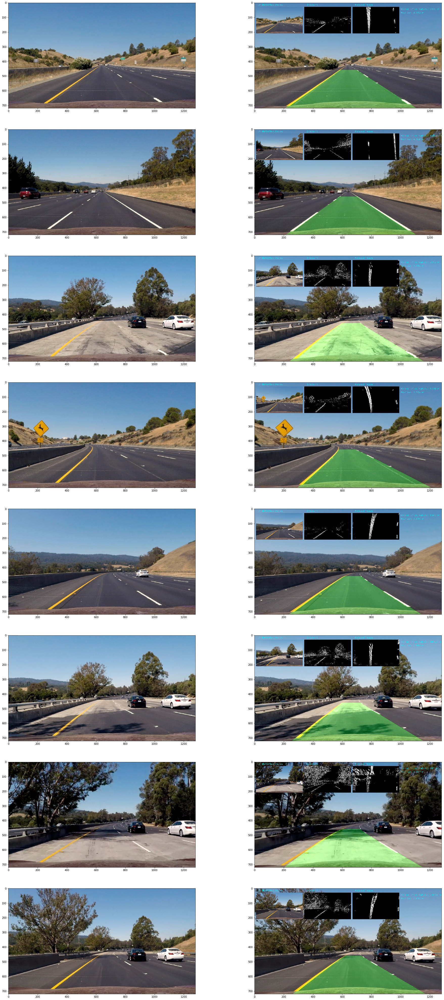

In [43]:

i = 1
no_test_imgs = len(images)
fig, axs = plt.subplots(no_test_imgs, 2, figsize=(16*2, 9*no_test_imgs))

axs = axs.ravel()
for i in range(no_test_imgs):
    img = cv2.imread(images[i])
    final_img = pipeline_image_processing(img)
    axs[i*2].imshow(np.flip(img,2))
    axs[i*2+1].imshow(np.flip(final_img,2))

# fig.imshow(np.flip(img,2))

In [44]:
fig.savefig('pipeline_processed.jpg', dpi=100)

# Video Processing

In [45]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [46]:
vid_output = 'test_videos_output/project_video_d1_full.mp4'
# averaging lanes over image frames

# averging_over_frames = np.empty((0,7), int)  #queue to store lane coordintes for averaging over no. of frames(given by 'no_frame_avg')
# no_frame_avg = 20  # this indicate the number on frames to average the lanes over
# slope_change_restriction='n'

# clip1 = VideoFileClip("project_video.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
output_clip = clip1.fl_image(pipeline_image_processing) #NOTE: this function expects color images!!

%time output_clip.write_videofile(vid_output, audio=False)

Average:  1655.679448272931 m
[MoviePy] >>>> Building video test_videos_output/project_video_d1_full.mp4
[MoviePy] Writing video test_videos_output/project_video_d1_full.mp4


  0%|                                                 | 0/1261 [00:00<?, ?it/s]

Average:  1655.679448272931 m


  0%|                                         | 1/1261 [00:00<14:21,  1.46it/s]

Average:  1088.6557698366937 m


  0%|                                         | 2/1261 [00:01<12:55,  1.62it/s]

Average:  574.225747008438 m


  0%|                                         | 3/1261 [00:01<12:11,  1.72it/s]

Average:  1219.5664413740537 m


  0%|▏                                        | 4/1261 [00:02<11:06,  1.88it/s]

Average:  1241.2646571867858 m


  0%|▏                                        | 5/1261 [00:02<10:55,  1.91it/s]

Average:  937.94998419894 m


  0%|▏                                        | 6/1261 [00:02<09:52,  2.12it/s]

Average:  922.6327354554801 m


  1%|▏                                        | 7/1261 [00:03<08:40,  2.41it/s]

Average:  833.866045675604 m


  1%|▎                                        | 8/1261 [00:03<08:13,  2.54it/s]

Average:  1078.9012590871093 m


  1%|▎                                        | 9/1261 [00:03<07:47,  2.68it/s]

Average:  1321.1283762478229 m


  1%|▎                                       | 10/1261 [00:04<07:12,  2.90it/s]

Average:  1469.837971766276 m


  1%|▎                                       | 11/1261 [00:04<07:00,  2.97it/s]

Average:  1393.3720648307278 m


  1%|▍                                       | 12/1261 [00:04<06:46,  3.07it/s]

Average:  2520.9959908867454 m


  1%|▍                                       | 13/1261 [00:05<07:07,  2.92it/s]

Average:  1245.3217832075263 m


  1%|▍                                       | 14/1261 [00:05<06:51,  3.03it/s]

Average:  2022.6998294534535 m


  1%|▍                                       | 15/1261 [00:05<06:35,  3.15it/s]

Average:  9525.944383567652 m


  1%|▌                                       | 16/1261 [00:06<06:28,  3.21it/s]

Average:  6327.498782830774 m


  1%|▌                                       | 17/1261 [00:06<06:11,  3.35it/s]

Average:  1545.509898674709 m


  1%|▌                                       | 18/1261 [00:06<05:56,  3.48it/s]

Average:  1528.4768125868695 m


  2%|▌                                       | 19/1261 [00:06<05:45,  3.59it/s]

Average:  2298.120714201675 m


  2%|▋                                       | 20/1261 [00:07<05:32,  3.74it/s]

Average:  1449.3728664177838 m


  2%|▋                                       | 21/1261 [00:07<05:20,  3.87it/s]

Average:  1016.0343016854899 m


  2%|▋                                       | 22/1261 [00:07<05:18,  3.89it/s]

Average:  928.3652789355702 m


  2%|▋                                       | 23/1261 [00:07<05:52,  3.51it/s]

Average:  1281.5705636587588 m


  2%|▊                                       | 24/1261 [00:08<05:31,  3.73it/s]

Average:  1170.459886599613 m


  2%|▊                                       | 25/1261 [00:08<05:44,  3.59it/s]

Average:  1003.1265787235611 m


  2%|▊                                       | 26/1261 [00:08<05:41,  3.62it/s]

Average:  1322.4034341846457 m


  2%|▊                                       | 27/1261 [00:08<05:30,  3.73it/s]

Average:  1515.3224036109023 m


  2%|▉                                       | 28/1261 [00:09<05:15,  3.91it/s]

Average:  1230.1679920007934 m


  2%|▉                                       | 29/1261 [00:09<05:13,  3.92it/s]

Average:  1370.2551393440265 m


  2%|▉                                       | 30/1261 [00:09<05:09,  3.97it/s]

Average:  905.3961205337664 m


  2%|▉                                       | 31/1261 [00:09<05:09,  3.97it/s]

Average:  867.6412080726445 m


  3%|█                                       | 32/1261 [00:10<05:01,  4.07it/s]

Average:  918.039108504367 m


  3%|█                                       | 33/1261 [00:10<05:14,  3.91it/s]

Average:  916.2105211491669 m


  3%|█                                       | 34/1261 [00:10<05:21,  3.81it/s]

Average:  1061.116320113752 m


  3%|█                                       | 35/1261 [00:11<05:41,  3.59it/s]

Average:  813.0472927895623 m


  3%|█▏                                      | 36/1261 [00:11<05:37,  3.63it/s]

Average:  592.9822208919601 m


  3%|█▏                                      | 37/1261 [00:11<05:33,  3.67it/s]

Average:  685.5295623095136 m


  3%|█▏                                      | 38/1261 [00:11<05:36,  3.63it/s]

Average:  1180.512000932822 m


  3%|█▏                                      | 39/1261 [00:12<05:17,  3.85it/s]

Average:  787.6801203199556 m


  3%|█▎                                      | 40/1261 [00:12<05:10,  3.93it/s]

Average:  1790.4056095074357 m


  3%|█▎                                      | 41/1261 [00:12<05:12,  3.90it/s]

Average:  1503.1949037639893 m


  3%|█▎                                      | 42/1261 [00:12<05:16,  3.86it/s]

Average:  7336.707312599058 m


  3%|█▎                                      | 43/1261 [00:13<05:32,  3.66it/s]

Average:  3661.850398517247 m


  3%|█▍                                      | 44/1261 [00:13<05:17,  3.83it/s]

Average:  1594.8808830746293 m


  4%|█▍                                      | 45/1261 [00:13<05:09,  3.92it/s]

Average:  1015.5983089205977 m


  4%|█▍                                      | 46/1261 [00:13<05:01,  4.03it/s]

Average:  1133.5606760746525 m


  4%|█▍                                      | 47/1261 [00:14<05:03,  4.00it/s]

Average:  946.618992433132 m


  4%|█▌                                      | 48/1261 [00:14<05:01,  4.02it/s]

Average:  906.3515901006474 m


  4%|█▌                                      | 49/1261 [00:14<05:07,  3.94it/s]

Average:  956.4437206970947 m


  4%|█▌                                      | 50/1261 [00:14<05:12,  3.87it/s]

Average:  696.1327565167861 m


  4%|█▌                                      | 51/1261 [00:15<05:08,  3.92it/s]

Average:  1044.7700268038388 m


  4%|█▋                                      | 52/1261 [00:15<05:01,  4.01it/s]

Average:  1532.4755202805936 m


  4%|█▋                                      | 53/1261 [00:15<04:51,  4.14it/s]

Average:  1728.2987767744253 m


  4%|█▋                                      | 54/1261 [00:15<05:31,  3.64it/s]

Average:  5741.403795510821 m


  4%|█▋                                      | 55/1261 [00:16<05:38,  3.56it/s]

Average:  12166.087208377836 m


  4%|█▊                                      | 56/1261 [00:16<05:43,  3.51it/s]

Average:  1585.3274855418401 m


  5%|█▊                                      | 57/1261 [00:16<05:36,  3.58it/s]

Average:  1366.946483394191 m


  5%|█▊                                      | 58/1261 [00:17<05:47,  3.46it/s]

Average:  1123.1657775195217 m


  5%|█▊                                      | 59/1261 [00:17<05:21,  3.74it/s]

Average:  968.1293651912497 m


  5%|█▉                                      | 60/1261 [00:17<05:05,  3.93it/s]

Average:  1360.1951372472106 m


  5%|█▉                                      | 61/1261 [00:17<04:58,  4.02it/s]

Average:  1274.8974701613522 m


  5%|█▉                                      | 62/1261 [00:18<04:49,  4.14it/s]

Average:  17894.97836168753 m


  5%|█▉                                      | 63/1261 [00:18<04:35,  4.35it/s]

Average:  4729.839949666884 m


  5%|██                                      | 64/1261 [00:18<04:29,  4.45it/s]

Average:  3703.8370385775443 m


  5%|██                                      | 65/1261 [00:18<04:38,  4.29it/s]

Average:  1890.1361537256216 m


  5%|██                                      | 66/1261 [00:18<04:32,  4.39it/s]

Average:  40953.71656839475 m


  5%|██▏                                     | 67/1261 [00:19<04:29,  4.43it/s]

Average:  1559.2441949831405 m


  5%|██▏                                     | 68/1261 [00:19<04:27,  4.45it/s]

Average:  1367.542539333697 m


  5%|██▏                                     | 69/1261 [00:19<04:35,  4.33it/s]

Average:  1026.4327750490215 m


  6%|██▏                                     | 70/1261 [00:19<04:35,  4.32it/s]

Average:  811.2591411280564 m


  6%|██▎                                     | 71/1261 [00:20<04:37,  4.29it/s]

Average:  1173.0311934160063 m


  6%|██▎                                     | 72/1261 [00:20<04:38,  4.27it/s]

Average:  2422.073516089749 m


  6%|██▎                                     | 73/1261 [00:20<04:42,  4.20it/s]

Average:  1847.7234954722917 m


  6%|██▎                                     | 74/1261 [00:20<04:48,  4.12it/s]

Average:  1640.992073548463 m


  6%|██▍                                     | 75/1261 [00:21<04:43,  4.19it/s]

Average:  4128.304100030269 m


  6%|██▍                                     | 76/1261 [00:21<04:34,  4.32it/s]

Average:  2318.9766891245736 m


  6%|██▍                                     | 77/1261 [00:21<04:31,  4.37it/s]

Average:  6951.5927389320495 m


  6%|██▍                                     | 78/1261 [00:21<04:38,  4.24it/s]

Average:  7529.440411810583 m


  6%|██▌                                     | 79/1261 [00:21<04:40,  4.21it/s]

Average:  4639.3960798673 m


  6%|██▌                                     | 80/1261 [00:22<04:33,  4.32it/s]

Average:  5101.629426231741 m


  6%|██▌                                     | 81/1261 [00:22<04:43,  4.16it/s]

Average:  1679.907395420228 m


  7%|██▌                                     | 82/1261 [00:22<04:48,  4.09it/s]

Average:  3120.1008234511173 m


  7%|██▋                                     | 83/1261 [00:22<04:35,  4.27it/s]

Average:  1662.3545865639633 m


  7%|██▋                                     | 84/1261 [00:23<04:41,  4.18it/s]

Average:  1418.2693679128186 m


  7%|██▋                                     | 85/1261 [00:23<04:37,  4.24it/s]

Average:  1583.2012663153296 m


  7%|██▋                                     | 86/1261 [00:23<04:41,  4.18it/s]

Average:  1482.3980117719814 m


  7%|██▊                                     | 87/1261 [00:23<04:36,  4.25it/s]

Average:  3539.3331153805066 m


  7%|██▊                                     | 88/1261 [00:24<04:39,  4.20it/s]

Average:  1781.5622463886655 m


  7%|██▊                                     | 89/1261 [00:24<04:45,  4.10it/s]

Average:  648.5854018194793 m


  7%|██▊                                     | 90/1261 [00:24<04:36,  4.24it/s]

Average:  1033.0486467163375 m


  7%|██▉                                     | 91/1261 [00:24<04:28,  4.36it/s]

Average:  1243.3092271923626 m


  7%|██▉                                     | 92/1261 [00:24<04:21,  4.47it/s]

Average:  998.782931657136 m


  7%|██▉                                     | 93/1261 [00:25<04:17,  4.54it/s]

Average:  981.6175987334391 m


  7%|██▉                                     | 94/1261 [00:25<04:19,  4.49it/s]

Average:  983.3361018570994 m


  8%|███                                     | 95/1261 [00:25<04:30,  4.31it/s]

Average:  897.1785798654334 m


  8%|███                                     | 96/1261 [00:25<04:31,  4.30it/s]

Average:  1832.7879117785737 m


  8%|███                                     | 97/1261 [00:26<04:31,  4.29it/s]

Average:  1252.2806102928914 m


  8%|███                                     | 98/1261 [00:26<04:24,  4.39it/s]

Average:  1216.3066872009547 m


  8%|███▏                                    | 99/1261 [00:26<04:32,  4.27it/s]

Average:  2267.193705367768 m


  8%|███                                    | 100/1261 [00:26<04:25,  4.36it/s]

Average:  2103.729709656406 m


  8%|███                                    | 101/1261 [00:27<04:19,  4.48it/s]

Average:  2146.6831741978654 m


  8%|███▏                                   | 102/1261 [00:27<04:14,  4.55it/s]

Average:  1394.963480983886 m


  8%|███▏                                   | 103/1261 [00:27<04:13,  4.56it/s]

Average:  1307.343901979771 m


  8%|███▏                                   | 104/1261 [00:27<04:28,  4.31it/s]

Average:  1165.3978814295037 m


  8%|███▏                                   | 105/1261 [00:27<04:23,  4.39it/s]

Average:  1329.249222681297 m


  8%|███▎                                   | 106/1261 [00:28<04:21,  4.42it/s]

Average:  1058.557795930058 m


  8%|███▎                                   | 107/1261 [00:28<04:19,  4.44it/s]

Average:  809.326526654508 m


  9%|███▎                                   | 108/1261 [00:28<04:18,  4.45it/s]

Average:  916.1992921843703 m


  9%|███▎                                   | 109/1261 [00:28<04:20,  4.42it/s]

Average:  1076.9454676781952 m


  9%|███▍                                   | 110/1261 [00:29<04:26,  4.32it/s]

Average:  856.2730438457655 m


  9%|███▍                                   | 111/1261 [00:29<04:34,  4.18it/s]

Average:  1126.9399846437905 m


  9%|███▍                                   | 112/1261 [00:29<04:37,  4.15it/s]

Average:  1315.2748403275982 m


  9%|███▍                                   | 113/1261 [00:29<04:35,  4.16it/s]

Average:  22044.177189958056 m


  9%|███▌                                   | 114/1261 [00:30<04:34,  4.18it/s]

Average:  4766.371646736179 m


  9%|███▌                                   | 115/1261 [00:30<04:30,  4.24it/s]

Average:  5104.562407580812 m


  9%|███▌                                   | 116/1261 [00:30<04:33,  4.19it/s]

Average:  7799.046623666108 m


  9%|███▌                                   | 117/1261 [00:30<04:27,  4.27it/s]

Average:  1268.6215142192236 m


  9%|███▋                                   | 118/1261 [00:31<04:34,  4.17it/s]

Average:  3925.026252696297 m


  9%|███▋                                   | 119/1261 [00:31<04:27,  4.26it/s]

Average:  1017.6292621196965 m


 10%|███▋                                   | 120/1261 [00:31<04:27,  4.27it/s]

Average:  792.6035447225507 m


 10%|███▋                                   | 121/1261 [00:31<04:28,  4.24it/s]

Average:  953.4864758944498 m


 10%|███▊                                   | 122/1261 [00:31<04:33,  4.17it/s]

Average:  774.8819072472353 m


 10%|███▊                                   | 123/1261 [00:32<04:24,  4.29it/s]

Average:  733.2523196882998 m


 10%|███▊                                   | 124/1261 [00:32<04:25,  4.29it/s]

Average:  727.2812243193207 m


 10%|███▊                                   | 125/1261 [00:32<04:25,  4.28it/s]

Average:  756.8693948094306 m


 10%|███▉                                   | 126/1261 [00:32<04:23,  4.30it/s]

Average:  829.3215597504711 m


 10%|███▉                                   | 127/1261 [00:33<04:11,  4.50it/s]

Average:  871.6204336017573 m


 10%|███▉                                   | 128/1261 [00:33<04:11,  4.50it/s]

Average:  6524.420666262934 m


 10%|███▉                                   | 129/1261 [00:33<04:09,  4.54it/s]

Average:  6799.367151052435 m


 10%|████                                   | 130/1261 [00:33<04:17,  4.39it/s]

Average:  2849.9487209408835 m


 10%|████                                   | 131/1261 [00:33<04:20,  4.35it/s]

Average:  2480.9110199817997 m


 10%|████                                   | 132/1261 [00:34<04:30,  4.17it/s]

Average:  59944.73885885262 m


 11%|████                                   | 133/1261 [00:34<05:01,  3.74it/s]

Average:  1477.379342024649 m


 11%|████▏                                  | 134/1261 [00:34<05:37,  3.34it/s]

Average:  1880.9604867806033 m


 11%|████▏                                  | 135/1261 [00:35<05:44,  3.27it/s]

Average:  905.9108772799333 m


 11%|████▏                                  | 136/1261 [00:35<05:30,  3.40it/s]

Average:  956.444182594742 m


 11%|████▏                                  | 137/1261 [00:35<05:04,  3.69it/s]

Average:  1231.694190167359 m


 11%|████▎                                  | 138/1261 [00:35<04:45,  3.93it/s]

Average:  1325.065390376415 m


 11%|████▎                                  | 139/1261 [00:36<04:31,  4.14it/s]

Average:  1524.7137938648054 m


 11%|████▎                                  | 140/1261 [00:36<04:20,  4.30it/s]

Average:  2701.4296857643894 m


 11%|████▎                                  | 141/1261 [00:36<04:22,  4.27it/s]

Average:  1780.3379565969367 m


 11%|████▍                                  | 142/1261 [00:36<04:28,  4.17it/s]

Average:  2789.8583709001646 m


 11%|████▍                                  | 143/1261 [00:37<04:27,  4.17it/s]

Average:  6286.167261669115 m


 11%|████▍                                  | 144/1261 [00:37<04:19,  4.30it/s]

Average:  2185.090548540261 m


 11%|████▍                                  | 145/1261 [00:37<04:19,  4.29it/s]

Average:  1686.9179295248534 m


 12%|████▌                                  | 146/1261 [00:37<04:20,  4.28it/s]

Average:  1417.8948323279867 m


 12%|████▌                                  | 147/1261 [00:38<04:20,  4.27it/s]

Average:  1151.5057689867222 m


 12%|████▌                                  | 148/1261 [00:38<04:20,  4.27it/s]

Average:  1412.6987267558795 m


 12%|████▌                                  | 149/1261 [00:38<04:20,  4.27it/s]

Average:  1514.8994157898615 m


 12%|████▋                                  | 150/1261 [00:38<04:14,  4.36it/s]

Average:  824.7346840503278 m


 12%|████▋                                  | 151/1261 [00:38<04:11,  4.42it/s]

Average:  973.1404235410756 m


 12%|████▋                                  | 152/1261 [00:39<04:35,  4.03it/s]

Average:  127147.2099411274 m


 12%|████▋                                  | 153/1261 [00:39<04:55,  3.74it/s]

Average:  3501.335116205746 m


 12%|████▊                                  | 154/1261 [00:39<05:13,  3.53it/s]

Average:  2691.4896281009087 m


 12%|████▊                                  | 155/1261 [00:40<05:05,  3.62it/s]

Average:  4101.224848531466 m


 12%|████▊                                  | 156/1261 [00:40<04:52,  3.77it/s]

Average:  2882.5449553163753 m


 12%|████▊                                  | 157/1261 [00:40<04:48,  3.82it/s]

Average:  1227.1136962579715 m


 13%|████▉                                  | 158/1261 [00:40<04:34,  4.02it/s]

Average:  825.5629871467575 m


 13%|████▉                                  | 159/1261 [00:41<04:34,  4.01it/s]

Average:  3941.42594007491 m


 13%|████▉                                  | 160/1261 [00:41<04:22,  4.19it/s]

Average:  1304.088899190358 m


 13%|████▉                                  | 161/1261 [00:41<04:26,  4.13it/s]

Average:  1576.0540024818436 m


 13%|█████                                  | 162/1261 [00:41<04:29,  4.08it/s]

Average:  1071.197804023222 m


 13%|█████                                  | 163/1261 [00:42<04:18,  4.25it/s]

Average:  1251.4003748879552 m


 13%|█████                                  | 164/1261 [00:42<04:22,  4.17it/s]

Average:  1156.2095860484756 m


 13%|█████                                  | 165/1261 [00:42<04:17,  4.26it/s]

Average:  36376.97685969762 m


 13%|█████▏                                 | 166/1261 [00:42<04:13,  4.31it/s]

Average:  764.3876851385396 m


 13%|█████▏                                 | 167/1261 [00:42<04:12,  4.34it/s]

Average:  1287.3106972806625 m


 13%|█████▏                                 | 168/1261 [00:43<04:12,  4.33it/s]

Average:  929.2027443740272 m


 13%|█████▏                                 | 169/1261 [00:43<04:15,  4.27it/s]

Average:  1238.6709825985586 m


 13%|█████▎                                 | 170/1261 [00:43<04:16,  4.25it/s]

Average:  1806.6076752672407 m


 14%|█████▎                                 | 171/1261 [00:43<04:14,  4.28it/s]

Average:  968.1211379461386 m


 14%|█████▎                                 | 172/1261 [00:44<04:24,  4.12it/s]

Average:  1302.7499036260886 m


 14%|█████▎                                 | 173/1261 [00:44<04:17,  4.22it/s]

Average:  834.1496492378354 m


 14%|█████▍                                 | 174/1261 [00:44<04:20,  4.17it/s]

Average:  1110.466765506551 m


 14%|█████▍                                 | 175/1261 [00:44<04:18,  4.20it/s]

Average:  1089.93498805553 m


 14%|█████▍                                 | 176/1261 [00:45<04:16,  4.23it/s]

Average:  980.6896173847465 m


 14%|█████▍                                 | 177/1261 [00:45<04:09,  4.35it/s]

Average:  1217.1739119763652 m


 14%|█████▌                                 | 178/1261 [00:45<04:15,  4.23it/s]

Average:  955.586564008188 m


 14%|█████▌                                 | 179/1261 [00:45<04:19,  4.18it/s]

Average:  1003.7491491728165 m


 14%|█████▌                                 | 180/1261 [00:46<04:22,  4.11it/s]

Average:  944.8828527943701 m


 14%|█████▌                                 | 181/1261 [00:46<04:16,  4.21it/s]

Average:  819.7739573390368 m


 14%|█████▋                                 | 182/1261 [00:46<04:13,  4.25it/s]

Average:  710.7631612595455 m


 15%|█████▋                                 | 183/1261 [00:46<04:08,  4.34it/s]

Average:  1967.804766499652 m


 15%|█████▋                                 | 184/1261 [00:46<04:11,  4.29it/s]

Average:  1830.6372168920848 m


 15%|█████▋                                 | 185/1261 [00:47<04:18,  4.16it/s]

Average:  2498.0936388323476 m


 15%|█████▊                                 | 186/1261 [00:47<04:13,  4.24it/s]

Average:  5660.7710020151335 m


 15%|█████▊                                 | 187/1261 [00:47<04:15,  4.20it/s]

Average:  696.7576430883736 m


 15%|█████▊                                 | 188/1261 [00:47<04:14,  4.21it/s]

Average:  649.7091909530977 m


 15%|█████▊                                 | 189/1261 [00:48<04:14,  4.22it/s]

Average:  611.6845357836423 m


 15%|█████▉                                 | 190/1261 [00:48<04:20,  4.11it/s]

Average:  871.5401690206434 m


 15%|█████▉                                 | 191/1261 [00:48<04:26,  4.01it/s]

Average:  917.2666255398808 m


 15%|█████▉                                 | 192/1261 [00:48<04:23,  4.06it/s]

Average:  1029.4255419106598 m


 15%|█████▉                                 | 193/1261 [00:49<04:21,  4.09it/s]

Average:  1129.7423565749602 m


 15%|██████                                 | 194/1261 [00:49<04:18,  4.12it/s]

Average:  920.9851648574336 m


 15%|██████                                 | 195/1261 [00:49<04:22,  4.06it/s]

Average:  2323.8651868154284 m


 16%|██████                                 | 196/1261 [00:49<04:18,  4.12it/s]

Average:  1185.488931770728 m


 16%|██████                                 | 197/1261 [00:50<04:15,  4.17it/s]

Average:  1053.128520400052 m


 16%|██████                                 | 198/1261 [00:50<04:17,  4.12it/s]

Average:  952.672147679004 m


 16%|██████▏                                | 199/1261 [00:50<04:14,  4.17it/s]

Average:  1144.3215959635172 m


 16%|██████▏                                | 200/1261 [00:50<04:23,  4.03it/s]

Average:  1737.3147313250138 m


 16%|██████▏                                | 201/1261 [00:51<04:17,  4.12it/s]

Average:  1197.5836325101045 m


 16%|██████▏                                | 202/1261 [00:51<04:08,  4.26it/s]

Average:  1433.8942470093698 m


 16%|██████▎                                | 203/1261 [00:51<04:10,  4.23it/s]

Average:  1423.8173730110516 m


 16%|██████▎                                | 204/1261 [00:51<04:11,  4.20it/s]

Average:  2941.9440545654656 m


 16%|██████▎                                | 205/1261 [00:52<04:10,  4.22it/s]

Average:  1715.6538833940017 m


 16%|██████▎                                | 206/1261 [00:52<04:15,  4.13it/s]

Average:  1010.606990927376 m


 16%|██████▍                                | 207/1261 [00:52<04:06,  4.28it/s]

Average:  2654.734103886039 m


 16%|██████▍                                | 208/1261 [00:52<04:10,  4.21it/s]

Average:  1380.208209833422 m


 17%|██████▍                                | 209/1261 [00:53<04:20,  4.03it/s]

Average:  983.6725367178892 m


 17%|██████▍                                | 210/1261 [00:53<04:26,  3.95it/s]

Average:  802.5616771347004 m


 17%|██████▌                                | 211/1261 [00:53<04:24,  3.96it/s]

Average:  909.4497797776808 m


 17%|██████▌                                | 212/1261 [00:53<04:19,  4.04it/s]

Average:  929.257817932338 m


 17%|██████▌                                | 213/1261 [00:54<04:04,  4.28it/s]

Average:  1218.0609743310642 m


 17%|██████▌                                | 214/1261 [00:54<04:09,  4.20it/s]

Average:  1187.938277144498 m


 17%|██████▋                                | 215/1261 [00:54<04:15,  4.09it/s]

Average:  951.6351871367922 m


 17%|██████▋                                | 216/1261 [00:54<04:15,  4.09it/s]

Average:  1295.7857171174946 m


 17%|██████▋                                | 217/1261 [00:54<04:10,  4.17it/s]

Average:  1190.3218785206009 m


 17%|██████▋                                | 218/1261 [00:55<04:13,  4.12it/s]

Average:  1286.7470706629445 m


 17%|██████▊                                | 219/1261 [00:55<04:12,  4.13it/s]

Average:  981.0984595984357 m


 17%|██████▊                                | 220/1261 [00:55<04:08,  4.19it/s]

Average:  1204.3850139958986 m


 18%|██████▊                                | 221/1261 [00:55<04:01,  4.30it/s]

Average:  1222.475860137451 m


 18%|██████▊                                | 222/1261 [00:56<03:59,  4.34it/s]

Average:  1664.5373834273407 m


 18%|██████▉                                | 223/1261 [00:56<03:54,  4.42it/s]

Average:  1903.492389429057 m


 18%|██████▉                                | 224/1261 [00:56<03:55,  4.40it/s]

Average:  724.2921383108694 m


 18%|██████▉                                | 225/1261 [00:56<03:52,  4.46it/s]

Average:  1950.7469836996145 m


 18%|██████▉                                | 226/1261 [00:57<03:52,  4.45it/s]

Average:  2736.6929741525278 m


 18%|███████                                | 227/1261 [00:57<03:50,  4.49it/s]

Average:  4651.9778116251855 m


 18%|███████                                | 228/1261 [00:57<03:56,  4.37it/s]

Average:  2488.1273537857824 m


 18%|███████                                | 229/1261 [00:57<03:52,  4.43it/s]

Average:  3793.319696840694 m


 18%|███████                                | 230/1261 [00:57<03:50,  4.48it/s]

Average:  2452.443011015641 m


 18%|███████▏                               | 231/1261 [00:58<03:45,  4.57it/s]

Average:  1612.464103815426 m


 18%|███████▏                               | 232/1261 [00:58<03:48,  4.50it/s]

Average:  1146.16243561319 m


 18%|███████▏                               | 233/1261 [00:58<03:46,  4.54it/s]

Average:  1422.8110916723058 m


 19%|███████▏                               | 234/1261 [00:58<03:50,  4.47it/s]

Average:  1179.634782843324 m


 19%|███████▎                               | 235/1261 [00:59<03:47,  4.51it/s]

Average:  1262.8097761833928 m


 19%|███████▎                               | 236/1261 [00:59<03:54,  4.37it/s]

Average:  927.577595648999 m


 19%|███████▎                               | 237/1261 [00:59<03:47,  4.50it/s]

Average:  1386.0936585184827 m


 19%|███████▎                               | 238/1261 [00:59<03:54,  4.36it/s]

Average:  1194.2018329218834 m


 19%|███████▍                               | 239/1261 [00:59<03:54,  4.35it/s]

Average:  1048.393557022419 m


 19%|███████▍                               | 240/1261 [01:00<03:59,  4.26it/s]

Average:  1459.0955686149875 m


 19%|███████▍                               | 241/1261 [01:00<03:53,  4.36it/s]

Average:  1588.0347469532614 m


 19%|███████▍                               | 242/1261 [01:00<03:54,  4.35it/s]

Average:  1853.0285095613913 m


 19%|███████▌                               | 243/1261 [01:00<03:51,  4.40it/s]

Average:  1628.295878374879 m


 19%|███████▌                               | 244/1261 [01:01<03:53,  4.36it/s]

Average:  3064.0864084423833 m


 19%|███████▌                               | 245/1261 [01:01<03:42,  4.56it/s]

Average:  752.285605067488 m


 20%|███████▌                               | 246/1261 [01:01<03:54,  4.33it/s]

Average:  872.0630057536919 m


 20%|███████▋                               | 247/1261 [01:01<04:04,  4.15it/s]

Average:  852.416011531834 m


 20%|███████▋                               | 248/1261 [01:02<04:00,  4.22it/s]

Average:  1262.9303993548933 m


 20%|███████▋                               | 249/1261 [01:02<03:52,  4.35it/s]

Average:  978.6109058243094 m


 20%|███████▋                               | 250/1261 [01:02<03:54,  4.32it/s]

Average:  1344.7982379338996 m


 20%|███████▊                               | 251/1261 [01:02<03:51,  4.36it/s]

Average:  1130.0270988174539 m


 20%|███████▊                               | 252/1261 [01:02<03:51,  4.35it/s]

Average:  1808.1287421173083 m


 20%|███████▊                               | 253/1261 [01:03<03:52,  4.33it/s]

Average:  1887.2563134418865 m


 20%|███████▊                               | 254/1261 [01:03<03:59,  4.20it/s]

Average:  2359.911183023975 m


 20%|███████▉                               | 255/1261 [01:03<04:08,  4.06it/s]

Average:  1391.7641162250711 m


 20%|███████▉                               | 256/1261 [01:03<04:09,  4.04it/s]

Average:  1218.9802931937234 m


 20%|███████▉                               | 257/1261 [01:04<04:14,  3.95it/s]

Average:  1404.0278387242197 m


 20%|███████▉                               | 258/1261 [01:04<04:32,  3.68it/s]

Average:  988.4614705161467 m


 21%|████████                               | 259/1261 [01:04<04:59,  3.34it/s]

Average:  1002.9526770643595 m


 21%|████████                               | 260/1261 [01:05<05:11,  3.22it/s]

Average:  1279.8117652295387 m


 21%|████████                               | 261/1261 [01:05<04:53,  3.41it/s]

Average:  1167.4070050028195 m


 21%|████████                               | 262/1261 [01:05<04:50,  3.44it/s]

Average:  1609.5291193725343 m


 21%|████████▏                              | 263/1261 [01:06<04:38,  3.58it/s]

Average:  1486.6136416057766 m


 21%|████████▏                              | 264/1261 [01:06<04:38,  3.58it/s]

Average:  1613.6353455970948 m


 21%|████████▏                              | 265/1261 [01:06<04:38,  3.57it/s]

Average:  1542.0408923260745 m


 21%|████████▏                              | 266/1261 [01:06<04:57,  3.34it/s]

Average:  1798.370807173659 m


 21%|████████▎                              | 267/1261 [01:07<04:51,  3.40it/s]

Average:  1319.2483442216294 m


 21%|████████▎                              | 268/1261 [01:07<04:39,  3.55it/s]

Average:  1013.7805550569192 m


 21%|████████▎                              | 269/1261 [01:07<04:25,  3.74it/s]

Average:  958.238274999959 m


 21%|████████▎                              | 270/1261 [01:07<04:15,  3.89it/s]

Average:  2013.5653301550017 m


 21%|████████▍                              | 271/1261 [01:08<04:12,  3.92it/s]

Average:  1519.0763479200832 m


 22%|████████▍                              | 272/1261 [01:08<04:05,  4.02it/s]

Average:  1377.539845994977 m


 22%|████████▍                              | 273/1261 [01:08<04:05,  4.02it/s]

Average:  11696.405360279156 m


 22%|████████▍                              | 274/1261 [01:08<04:05,  4.01it/s]

Average:  2760.128884014198 m


 22%|████████▌                              | 275/1261 [01:09<03:56,  4.17it/s]

Average:  3279.471852985808 m


 22%|████████▌                              | 276/1261 [01:09<04:03,  4.04it/s]

Average:  1249.4784165399528 m


 22%|████████▌                              | 277/1261 [01:09<04:04,  4.03it/s]

Average:  1143.5338359192667 m


 22%|████████▌                              | 278/1261 [01:09<04:04,  4.02it/s]

Average:  1055.470379037208 m


 22%|████████▋                              | 279/1261 [01:10<04:00,  4.09it/s]

Average:  1232.7552299047486 m


 22%|████████▋                              | 280/1261 [01:10<04:01,  4.07it/s]

Average:  1262.5301538593826 m


 22%|████████▋                              | 281/1261 [01:10<03:52,  4.21it/s]

Average:  1798.3052210736078 m


 22%|████████▋                              | 282/1261 [01:10<03:51,  4.23it/s]

Average:  2006.975305592452 m


 22%|████████▊                              | 283/1261 [01:11<03:50,  4.24it/s]

Average:  3355.6193247891474 m


 23%|████████▊                              | 284/1261 [01:11<03:45,  4.34it/s]

Average:  894.0166089505076 m


 23%|████████▊                              | 285/1261 [01:11<03:41,  4.41it/s]

Average:  5045.729258220293 m


 23%|████████▊                              | 286/1261 [01:11<03:39,  4.43it/s]

Average:  1902.828249090467 m


 23%|████████▉                              | 287/1261 [01:11<03:37,  4.48it/s]

Average:  4451.994388623678 m


 23%|████████▉                              | 288/1261 [01:12<03:40,  4.41it/s]

Average:  1076.2646346842903 m


 23%|████████▉                              | 289/1261 [01:12<03:37,  4.46it/s]

Average:  5069.390159939204 m


 23%|████████▉                              | 290/1261 [01:12<03:45,  4.31it/s]

Average:  1656.9385171849513 m


 23%|█████████                              | 291/1261 [01:12<03:50,  4.22it/s]

Average:  1696.480370903722 m


 23%|█████████                              | 292/1261 [01:13<03:44,  4.32it/s]

Average:  1682.1142170315945 m


 23%|█████████                              | 293/1261 [01:13<03:53,  4.14it/s]

Average:  1484.1582418656249 m


 23%|█████████                              | 294/1261 [01:13<03:46,  4.26it/s]

Average:  2231.5505457618997 m


 23%|█████████                              | 295/1261 [01:13<03:41,  4.35it/s]

Average:  2527.21856273496 m


 23%|█████████▏                             | 296/1261 [01:14<03:47,  4.24it/s]

Average:  2273.5774421892593 m


 24%|█████████▏                             | 297/1261 [01:14<03:37,  4.43it/s]

Average:  6235.250909937272 m


 24%|█████████▏                             | 298/1261 [01:14<03:39,  4.38it/s]

Average:  8737.869724345337 m


 24%|█████████▏                             | 299/1261 [01:14<03:32,  4.53it/s]

Average:  4426.239846157878 m


 24%|█████████▎                             | 300/1261 [01:14<03:31,  4.55it/s]

Average:  2105.4987160463497 m


 24%|█████████▎                             | 301/1261 [01:15<03:26,  4.65it/s]

Average:  10468.082624610783 m


 24%|█████████▎                             | 302/1261 [01:15<03:31,  4.53it/s]

Average:  2517.4801404396458 m


 24%|█████████▎                             | 303/1261 [01:15<03:30,  4.55it/s]

Average:  2199.0243471106787 m


 24%|█████████▍                             | 304/1261 [01:15<03:34,  4.46it/s]

Average:  4866.11573500148 m


 24%|█████████▍                             | 305/1261 [01:16<03:28,  4.59it/s]

Average:  1905.1440136019946 m


 24%|█████████▍                             | 306/1261 [01:16<03:23,  4.69it/s]

Average:  7207.752458717563 m


 24%|█████████▍                             | 307/1261 [01:16<03:25,  4.65it/s]

Average:  9893.80721000674 m


 24%|█████████▌                             | 308/1261 [01:16<03:25,  4.63it/s]

Average:  4760.915314837331 m


 25%|█████████▌                             | 309/1261 [01:16<03:30,  4.52it/s]

Average:  7190.728998169128 m


 25%|█████████▌                             | 310/1261 [01:17<03:29,  4.54it/s]

Average:  3650.1659822431884 m


 25%|█████████▌                             | 311/1261 [01:17<03:28,  4.55it/s]

Average:  13770.050518304219 m


 25%|█████████▋                             | 312/1261 [01:17<03:28,  4.56it/s]

Average:  4030.754495453541 m


 25%|█████████▋                             | 313/1261 [01:17<03:23,  4.66it/s]

Average:  53284.20087969684 m


 25%|█████████▋                             | 314/1261 [01:17<03:24,  4.64it/s]

Average:  61046.27992265008 m


 25%|█████████▋                             | 315/1261 [01:18<03:20,  4.72it/s]

Average:  20577.59060037538 m


 25%|█████████▊                             | 316/1261 [01:18<03:26,  4.58it/s]

Average:  8584.378076262343 m


 25%|█████████▊                             | 317/1261 [01:18<03:35,  4.39it/s]

Average:  7068.525181829644 m


 25%|█████████▊                             | 318/1261 [01:18<03:40,  4.27it/s]

Average:  93141.77607785373 m


 25%|█████████▊                             | 319/1261 [01:19<03:40,  4.27it/s]

Average:  13124.721944551497 m


 25%|█████████▉                             | 320/1261 [01:19<03:49,  4.11it/s]

Average:  9428.962987533354 m


 25%|█████████▉                             | 321/1261 [01:19<03:50,  4.08it/s]

Average:  5566.36458125388 m


 26%|█████████▉                             | 322/1261 [01:19<03:42,  4.21it/s]

Average:  7660.34564486162 m


 26%|█████████▉                             | 323/1261 [01:20<03:41,  4.23it/s]

Average:  24571.53571410216 m


 26%|██████████                             | 324/1261 [01:20<03:40,  4.24it/s]

Average:  3170.3268658066117 m


 26%|██████████                             | 325/1261 [01:20<03:40,  4.25it/s]

Average:  4149.532335181863 m


 26%|██████████                             | 326/1261 [01:20<03:35,  4.35it/s]

Average:  3543.664359215906 m


 26%|██████████                             | 327/1261 [01:21<03:27,  4.51it/s]

Average:  3279.1370428668984 m


 26%|██████████▏                            | 328/1261 [01:21<03:26,  4.53it/s]

Average:  4548.514387545388 m


 26%|██████████▏                            | 329/1261 [01:21<03:20,  4.64it/s]

Average:  21034.181646010456 m


 26%|██████████▏                            | 330/1261 [01:21<03:25,  4.52it/s]

Average:  6377.9563475504365 m


 26%|██████████▏                            | 331/1261 [01:21<03:24,  4.54it/s]

Average:  5183.558548337542 m


 26%|██████████▎                            | 332/1261 [01:22<03:24,  4.55it/s]

Average:  15376.645478253704 m


 26%|██████████▎                            | 333/1261 [01:22<03:19,  4.66it/s]

Average:  8248.325990344623 m


 26%|██████████▎                            | 334/1261 [01:22<03:24,  4.54it/s]

Average:  8328.464538313594 m


 27%|██████████▎                            | 335/1261 [01:22<03:23,  4.55it/s]

Average:  134567.86989292593 m


 27%|██████████▍                            | 336/1261 [01:22<03:27,  4.46it/s]

Average:  12200.661703657726 m


 27%|██████████▍                            | 337/1261 [01:23<03:34,  4.31it/s]

Average:  14549.28983910218 m


 27%|██████████▍                            | 338/1261 [01:23<03:34,  4.30it/s]

Average:  59674.489649258714 m


 27%|██████████▍                            | 339/1261 [01:23<03:34,  4.29it/s]

Average:  52998.578120555576 m


 27%|██████████▌                            | 340/1261 [01:23<03:34,  4.29it/s]

Average:  4703.563955508838 m


 27%|██████████▌                            | 341/1261 [01:24<03:34,  4.28it/s]

Average:  4865.131593531052 m


 27%|██████████▌                            | 342/1261 [01:24<03:34,  4.28it/s]

Average:  2989.34063005833 m


 27%|██████████▌                            | 343/1261 [01:24<03:35,  4.27it/s]

Average:  2061.435107485176 m


 27%|██████████▋                            | 344/1261 [01:24<03:30,  4.36it/s]

Average:  3390.0540681724606 m


 27%|██████████▋                            | 345/1261 [01:25<03:27,  4.42it/s]

Average:  2473.2864192039083 m


 27%|██████████▋                            | 346/1261 [01:25<03:29,  4.38it/s]

Average:  2207.8941213298995 m


 28%|██████████▋                            | 347/1261 [01:25<03:30,  4.34it/s]

Average:  2290.440167180056 m


 28%|██████████▊                            | 348/1261 [01:25<03:35,  4.24it/s]

Average:  3747.5894699078685 m


 28%|██████████▊                            | 349/1261 [01:26<03:30,  4.33it/s]

Average:  9126.010039275472 m


 28%|██████████▊                            | 350/1261 [01:26<03:39,  4.15it/s]

Average:  30621.977513531263 m


 28%|██████████▊                            | 351/1261 [01:26<03:33,  4.27it/s]

Average:  7203.898388982334 m


 28%|██████████▉                            | 352/1261 [01:26<03:33,  4.26it/s]

Average:  5694.430999239923 m


 28%|██████████▉                            | 353/1261 [01:26<03:28,  4.35it/s]

Average:  2799.6368081760943 m


 28%|██████████▉                            | 354/1261 [01:27<03:29,  4.33it/s]

Average:  2194.892264647787 m


 28%|██████████▉                            | 355/1261 [01:27<03:30,  4.31it/s]

Average:  1902.1299185867715 m


 28%|███████████                            | 356/1261 [01:27<03:34,  4.22it/s]

Average:  1981.4872229279304 m


 28%|███████████                            | 357/1261 [01:27<03:29,  4.32it/s]

Average:  1956.3648069521184 m


 28%|███████████                            | 358/1261 [01:28<03:29,  4.30it/s]

Average:  2276.6044699424074 m


 28%|███████████                            | 359/1261 [01:28<03:29,  4.30it/s]

Average:  4253.790532595155 m


 29%|███████████▏                           | 360/1261 [01:29<05:19,  2.82it/s]

Average:  7931.494203050208 m


 29%|███████████▏                           | 361/1261 [01:29<07:56,  1.89it/s]

Average:  17309.75616412483 m


 29%|███████████▏                           | 362/1261 [01:30<10:12,  1.47it/s]

Average:  5703.616227121044 m


 29%|███████████▏                           | 363/1261 [01:31<11:16,  1.33it/s]

Average:  24801.123121572087 m


 29%|███████████▎                           | 364/1261 [01:32<12:00,  1.24it/s]

Average:  1510.3057335463448 m


 29%|███████████▎                           | 365/1261 [01:33<12:01,  1.24it/s]

Average:  2982.2123827302707 m


 29%|███████████▎                           | 366/1261 [01:34<12:15,  1.22it/s]

Average:  2936.267823685145 m


 29%|███████████▎                           | 367/1261 [01:35<11:29,  1.30it/s]

Average:  10561.194588630644 m


 29%|███████████▍                           | 368/1261 [01:35<10:53,  1.37it/s]

Average:  6620.030544071548 m


 29%|███████████▍                           | 369/1261 [01:36<10:36,  1.40it/s]

Average:  780.2900806206698 m


 29%|███████████▍                           | 370/1261 [01:37<10:11,  1.46it/s]

Average:  8704.701775626243 m


 29%|███████████▍                           | 371/1261 [01:37<09:54,  1.50it/s]

Average:  3274.098742660442 m


 30%|███████████▌                           | 372/1261 [01:38<09:54,  1.50it/s]

Average:  4484.914685750812 m


 30%|███████████▌                           | 373/1261 [01:38<09:25,  1.57it/s]

Average:  8158.617128509193 m


 30%|███████████▌                           | 374/1261 [01:39<09:00,  1.64it/s]

Average:  5071.088352317646 m


 30%|███████████▌                           | 375/1261 [01:40<08:36,  1.72it/s]

Average:  40549.02921745641 m


 30%|███████████▋                           | 376/1261 [01:40<08:17,  1.78it/s]

Average:  17314.87481728375 m


 30%|███████████▋                           | 377/1261 [01:41<08:00,  1.84it/s]

Average:  5220.917209656196 m


 30%|███████████▋                           | 378/1261 [01:41<07:44,  1.90it/s]

Average:  3479.6265339988577 m


 30%|███████████▋                           | 379/1261 [01:41<07:32,  1.95it/s]

Average:  3900.5103202786668 m


 30%|███████████▊                           | 380/1261 [01:42<07:28,  1.97it/s]

Average:  4211.516905185046 m


 30%|███████████▊                           | 381/1261 [01:42<07:16,  2.01it/s]

Average:  5379.238014262624 m


 30%|███████████▊                           | 382/1261 [01:43<06:56,  2.11it/s]

Average:  8530.269122462014 m


 30%|███████████▊                           | 383/1261 [01:43<06:38,  2.21it/s]

Average:  5000.067025696572 m


 30%|███████████▉                           | 384/1261 [01:44<06:33,  2.23it/s]

Average:  8310.145239256573 m


 31%|███████████▉                           | 385/1261 [01:44<06:25,  2.27it/s]

Average:  50576.83009076066 m


 31%|███████████▉                           | 386/1261 [01:45<06:24,  2.28it/s]

Average:  27799.218440130266 m


 31%|███████████▉                           | 387/1261 [01:45<07:12,  2.02it/s]

Average:  23510.35281342169 m


 31%|████████████                           | 388/1261 [01:46<07:25,  1.96it/s]

Average:  35183.50165570821 m


 31%|████████████                           | 389/1261 [01:46<07:26,  1.96it/s]

Average:  7421.378243780983 m


 31%|████████████                           | 390/1261 [01:47<07:05,  2.04it/s]

Average:  5220.162642902295 m


 31%|████████████                           | 391/1261 [01:47<06:51,  2.11it/s]

Average:  19880.053905247125 m


 31%|████████████                           | 392/1261 [01:48<06:49,  2.12it/s]

Average:  11367.851870378587 m


 31%|████████████▏                          | 393/1261 [01:48<06:40,  2.17it/s]

Average:  15625.458725553577 m


 31%|████████████▏                          | 394/1261 [01:48<06:30,  2.22it/s]

Average:  4355.251057069023 m


 31%|████████████▏                          | 395/1261 [01:49<06:06,  2.36it/s]

Average:  5579.951950297093 m


 31%|████████████▏                          | 396/1261 [01:49<06:01,  2.39it/s]

Average:  6550.596018248005 m


 31%|████████████▎                          | 397/1261 [01:50<05:49,  2.47it/s]

Average:  6528.310182557278 m


 32%|████████████▎                          | 398/1261 [01:50<05:29,  2.62it/s]

Average:  57176.81768435278 m


 32%|████████████▎                          | 399/1261 [01:50<05:19,  2.70it/s]

Average:  9007.040726831836 m


 32%|████████████▎                          | 400/1261 [01:51<04:59,  2.87it/s]

Average:  5567.04980460503 m


 32%|████████████▍                          | 401/1261 [01:51<04:50,  2.97it/s]

Average:  4022.5549383169846 m


 32%|████████████▍                          | 402/1261 [01:51<04:39,  3.08it/s]

Average:  3750.1750281571444 m


 32%|████████████▍                          | 403/1261 [01:51<04:36,  3.11it/s]

Average:  6649.153470337027 m


 32%|████████████▍                          | 404/1261 [01:52<04:41,  3.05it/s]

Average:  7448.534841503282 m


 32%|████████████▌                          | 405/1261 [01:52<04:32,  3.14it/s]

Average:  21859.718288741482 m


 32%|████████████▌                          | 406/1261 [01:53<05:58,  2.38it/s]

Average:  3363.164826008605 m


 32%|████████████▌                          | 407/1261 [01:53<07:00,  2.03it/s]

Average:  2705.239358370335 m


 32%|████████████▌                          | 408/1261 [01:54<07:29,  1.90it/s]

Average:  4180.460299849763 m


 32%|████████████▋                          | 409/1261 [01:55<07:43,  1.84it/s]

Average:  8688.41876261702 m


 33%|████████████▋                          | 410/1261 [01:55<07:23,  1.92it/s]

Average:  17814.695219302528 m


 33%|████████████▋                          | 411/1261 [01:56<07:09,  1.98it/s]

Average:  156047.39680965553 m


 33%|████████████▋                          | 412/1261 [01:56<06:47,  2.08it/s]

Average:  12499.045211592605 m


 33%|████████████▊                          | 413/1261 [01:56<06:16,  2.25it/s]

Average:  8255.058853245599 m


 33%|████████████▊                          | 414/1261 [01:57<05:50,  2.41it/s]

Average:  7051.495413977023 m


 33%|████████████▊                          | 415/1261 [01:57<05:32,  2.55it/s]

Average:  3629.349617545946 m


 33%|████████████▊                          | 416/1261 [01:57<05:23,  2.61it/s]

Average:  2016.2330915554003 m


 33%|████████████▉                          | 417/1261 [01:58<05:05,  2.77it/s]

Average:  2204.566895866566 m


 33%|████████████▉                          | 418/1261 [01:58<04:52,  2.89it/s]

Average:  2402.0229010312396 m


 33%|████████████▉                          | 419/1261 [01:58<04:32,  3.09it/s]

Average:  2574.911449373152 m


 33%|████████████▉                          | 420/1261 [01:59<04:21,  3.22it/s]

Average:  3789.198572565513 m


 33%|█████████████                          | 421/1261 [01:59<04:01,  3.47it/s]

Average:  7271.210981324046 m


 33%|█████████████                          | 422/1261 [01:59<03:47,  3.68it/s]

Average:  11259.14320471431 m


 34%|█████████████                          | 423/1261 [01:59<03:42,  3.77it/s]

Average:  7847.805339211267 m


 34%|█████████████                          | 424/1261 [02:00<03:41,  3.77it/s]

Average:  4334.3427395273575 m


 34%|█████████████▏                         | 425/1261 [02:00<03:33,  3.91it/s]

Average:  2959.4569771079123 m


 34%|█████████████▏                         | 426/1261 [02:00<03:28,  4.01it/s]

Average:  4075.2182833662 m


 34%|█████████████▏                         | 427/1261 [02:00<03:24,  4.09it/s]

Average:  5434.9162134617 m


 34%|█████████████▏                         | 428/1261 [02:01<03:25,  4.06it/s]

Average:  8429.740504197594 m


 34%|█████████████▎                         | 429/1261 [02:01<03:19,  4.18it/s]

Average:  8823.58000565088 m


 34%|█████████████▎                         | 430/1261 [02:01<03:21,  4.13it/s]

Average:  4215.957014287215 m


 34%|█████████████▎                         | 431/1261 [02:01<03:16,  4.21it/s]

Average:  6195.813561239485 m


 34%|█████████████▎                         | 432/1261 [02:01<03:19,  4.15it/s]

Average:  13285.711751243864 m


 34%|█████████████▍                         | 433/1261 [02:02<03:13,  4.27it/s]

Average:  4240.641926504262 m


 34%|█████████████▍                         | 434/1261 [02:02<03:09,  4.36it/s]

Average:  6683.293797022212 m


 34%|█████████████▍                         | 435/1261 [02:02<03:18,  4.16it/s]

Average:  12841.033416540193 m


 35%|█████████████▍                         | 436/1261 [02:02<03:13,  4.27it/s]

Average:  31973.712710154083 m


 35%|█████████████▌                         | 437/1261 [02:03<03:09,  4.36it/s]

Average:  14833.462308944834 m


 35%|█████████████▌                         | 438/1261 [02:03<03:10,  4.33it/s]

Average:  8268.408485208647 m


 35%|█████████████▌                         | 439/1261 [02:03<03:18,  4.15it/s]

Average:  4344.106963136413 m


 35%|█████████████▌                         | 440/1261 [02:03<03:16,  4.18it/s]

Average:  4346.928922768318 m


 35%|█████████████▋                         | 441/1261 [02:04<03:14,  4.21it/s]

Average:  3885.2160557999305 m


 35%|█████████████▋                         | 442/1261 [02:04<03:13,  4.23it/s]

Average:  2757.7291023771904 m


 35%|█████████████▋                         | 443/1261 [02:04<03:08,  4.33it/s]

Average:  2679.373604300628 m


 35%|█████████████▋                         | 444/1261 [02:04<03:09,  4.31it/s]

Average:  2715.977592884897 m


 35%|█████████████▊                         | 445/1261 [02:04<03:05,  4.39it/s]

Average:  22683.973115099983 m


 35%|█████████████▊                         | 446/1261 [02:05<03:03,  4.44it/s]

Average:  4724.38638490706 m


 35%|█████████████▊                         | 447/1261 [02:05<03:01,  4.48it/s]

Average:  6954.44010661846 m


 36%|█████████████▊                         | 448/1261 [02:05<03:00,  4.51it/s]

Average:  381156.6708172887 m


 36%|█████████████▉                         | 449/1261 [02:05<02:59,  4.53it/s]

Average:  11476.337054050913 m


 36%|█████████████▉                         | 450/1261 [02:06<03:02,  4.45it/s]

Average:  2400.619790525772 m


 36%|█████████████▉                         | 451/1261 [02:06<03:00,  4.49it/s]

Average:  2765.365117868017 m


 36%|█████████████▉                         | 452/1261 [02:06<03:02,  4.42it/s]

Average:  4287.143539029661 m


 36%|██████████████                         | 453/1261 [02:06<03:05,  4.37it/s]

Average:  15783.525760950808 m


 36%|██████████████                         | 454/1261 [02:07<03:06,  4.34it/s]

Average:  92185.43002111344 m


 36%|██████████████                         | 455/1261 [02:07<03:07,  4.29it/s]

Average:  5369.648085343791 m


 36%|██████████████                         | 456/1261 [02:07<03:11,  4.20it/s]

Average:  5706.593561800408 m


 36%|██████████████▏                        | 457/1261 [02:07<03:17,  4.06it/s]

Average:  5702.145656653188 m


 36%|██████████████▏                        | 458/1261 [02:08<03:18,  4.05it/s]

Average:  32425.44593259322 m


 36%|██████████████▏                        | 459/1261 [02:08<04:52,  2.74it/s]

Average:  33442.68633110075 m


 36%|██████████████▏                        | 460/1261 [02:09<06:05,  2.19it/s]

Average:  5237.630464367935 m


 37%|██████████████▎                        | 461/1261 [02:09<06:28,  2.06it/s]

Average:  2575.832094303592 m


 37%|██████████████▎                        | 462/1261 [02:10<06:27,  2.06it/s]

Average:  2420.1504406137465 m


 37%|██████████████▎                        | 463/1261 [02:10<06:06,  2.18it/s]

Average:  2630.351285582312 m


 37%|██████████████▎                        | 464/1261 [02:11<05:45,  2.30it/s]

Average:  2379.2950586041115 m


 37%|██████████████▍                        | 465/1261 [02:11<05:35,  2.38it/s]

Average:  2042.3841768486332 m


 37%|██████████████▍                        | 466/1261 [02:11<05:23,  2.46it/s]

Average:  2365.85846025055 m


 37%|██████████████▍                        | 467/1261 [02:12<05:00,  2.64it/s]

Average:  2139.6940012187015 m


 37%|██████████████▍                        | 468/1261 [02:12<04:40,  2.83it/s]

Average:  3268.9190455733915 m


 37%|██████████████▌                        | 469/1261 [02:12<04:26,  2.97it/s]

Average:  3266.4909358655477 m


 37%|██████████████▌                        | 470/1261 [02:13<04:12,  3.13it/s]

Average:  3520.768992918094 m


 37%|██████████████▌                        | 471/1261 [02:13<04:03,  3.25it/s]

Average:  3645.312188163939 m


 37%|██████████████▌                        | 472/1261 [02:13<03:56,  3.33it/s]

Average:  3459.014643332786 m


 38%|██████████████▋                        | 473/1261 [02:13<04:02,  3.24it/s]

Average:  9043.53375497877 m


 38%|██████████████▋                        | 474/1261 [02:14<04:07,  3.18it/s]

Average:  4078.8369130403507 m


 38%|██████████████▋                        | 475/1261 [02:14<03:58,  3.29it/s]

Average:  6382.1721392099325 m


 38%|██████████████▋                        | 476/1261 [02:14<03:53,  3.37it/s]

Average:  7462.171409284536 m


 38%|██████████████▊                        | 477/1261 [02:15<03:41,  3.54it/s]

Average:  101158.65707210246 m


 38%|██████████████▊                        | 478/1261 [02:15<03:37,  3.60it/s]

Average:  16859.47403443107 m


 38%|██████████████▊                        | 479/1261 [02:15<03:30,  3.72it/s]

Average:  3691.786451777274 m


 38%|██████████████▊                        | 480/1261 [02:15<03:29,  3.73it/s]

Average:  6864.629780262608 m


 38%|██████████████▉                        | 481/1261 [02:16<03:21,  3.88it/s]

Average:  3601.6139312162372 m


 38%|██████████████▉                        | 482/1261 [02:16<03:15,  3.99it/s]

Average:  6239.669046003751 m


 38%|██████████████▉                        | 483/1261 [02:16<03:11,  4.07it/s]

Average:  6886.282771506512 m


 38%|██████████████▉                        | 484/1261 [02:16<03:11,  4.06it/s]

Average:  24341.78477268445 m


 38%|███████████████                        | 485/1261 [02:17<03:08,  4.12it/s]

Average:  77712.38141781717 m


 39%|███████████████                        | 486/1261 [02:17<03:06,  4.16it/s]

Average:  10678.489892740608 m


 39%|███████████████                        | 487/1261 [02:17<03:04,  4.20it/s]

Average:  6770.08816098995 m


 39%|███████████████                        | 488/1261 [02:17<03:06,  4.14it/s]

Average:  126454.0097155036 m


 39%|███████████████                        | 489/1261 [02:18<03:04,  4.18it/s]

Average:  7633.315121259642 m


 39%|███████████████▏                       | 490/1261 [02:18<03:06,  4.12it/s]

Average:  4986.471598865855 m


 39%|███████████████▏                       | 491/1261 [02:18<03:08,  4.09it/s]

Average:  7354.579382935437 m


 39%|███████████████▏                       | 492/1261 [02:18<03:09,  4.06it/s]

Average:  21555.584432269487 m


 39%|███████████████▏                       | 493/1261 [02:19<03:06,  4.12it/s]

Average:  9214.944744668966 m


 39%|███████████████▎                       | 494/1261 [02:19<03:04,  4.17it/s]

Average:  6921.858804970504 m


 39%|███████████████▎                       | 495/1261 [02:19<03:06,  4.12it/s]

Average:  9424.930160123818 m


 39%|███████████████▎                       | 496/1261 [02:19<03:03,  4.16it/s]

Average:  7925.0492067417745 m


 39%|███████████████▎                       | 497/1261 [02:19<02:58,  4.28it/s]

Average:  13805.207359153777 m


 39%|███████████████▍                       | 498/1261 [02:20<02:58,  4.28it/s]

Average:  22848.85262811176 m


 40%|███████████████▍                       | 499/1261 [02:20<02:51,  4.45it/s]

Average:  10037.781332152024 m


 40%|███████████████▍                       | 500/1261 [02:20<02:56,  4.31it/s]

Average:  56192.346684587064 m


 40%|███████████████▍                       | 501/1261 [02:20<02:53,  4.39it/s]

Average:  6824.712652591199 m


 40%|███████████████▌                       | 502/1261 [02:21<02:50,  4.44it/s]

Average:  17439.40594173347 m


 40%|███████████████▌                       | 503/1261 [02:21<02:52,  4.39it/s]

Average:  5072.080191074545 m


 40%|███████████████▌                       | 504/1261 [02:21<02:53,  4.35it/s]

Average:  6513.248061828993 m


 40%|███████████████▌                       | 505/1261 [02:21<02:51,  4.41it/s]

Average:  10200.17296244899 m


 40%|███████████████▋                       | 506/1261 [02:22<02:56,  4.28it/s]

Average:  32360.178057872894 m


 40%|███████████████▋                       | 507/1261 [02:22<02:52,  4.36it/s]

Average:  22883.852493543072 m


 40%|███████████████▋                       | 508/1261 [02:22<02:53,  4.34it/s]

Average:  9497.757815321938 m


 40%|███████████████▋                       | 509/1261 [02:22<02:54,  4.32it/s]

Average:  6652.80392687407 m


 40%|███████████████▊                       | 510/1261 [02:22<02:54,  4.30it/s]

Average:  4181.692586064342 m


 41%|███████████████▊                       | 511/1261 [02:23<02:54,  4.29it/s]

Average:  3549.1764135102103 m


 41%|███████████████▊                       | 512/1261 [02:23<02:54,  4.29it/s]

Average:  2586.6303556527537 m


 41%|███████████████▊                       | 513/1261 [02:23<02:54,  4.28it/s]

Average:  2622.5639268956947 m


 41%|███████████████▉                       | 514/1261 [02:23<02:58,  4.18it/s]

Average:  2705.3811529920845 m


 41%|███████████████▉                       | 515/1261 [02:24<02:57,  4.21it/s]

Average:  1864.5860362517496 m


 41%|███████████████▉                       | 516/1261 [02:24<02:56,  4.23it/s]

Average:  1873.1364793119108 m


 41%|███████████████▉                       | 517/1261 [02:24<02:51,  4.33it/s]

Average:  4846.47508540315 m


 41%|████████████████                       | 518/1261 [02:24<02:47,  4.43it/s]

Average:  5849.283802527718 m


 41%|████████████████                       | 519/1261 [02:24<02:45,  4.48it/s]

Average:  3119.457372953383 m


 41%|████████████████                       | 520/1261 [02:25<02:51,  4.32it/s]

Average:  28213.37260130146 m


 41%|████████████████                       | 521/1261 [02:25<02:51,  4.31it/s]

Average:  2816.2660640848717 m


 41%|████████████████▏                      | 522/1261 [02:25<02:48,  4.39it/s]

Average:  4931.06433296526 m


 41%|████████████████▏                      | 523/1261 [02:25<02:49,  4.35it/s]

Average:  3547.639568673817 m


 42%|████████████████▏                      | 524/1261 [02:26<02:50,  4.33it/s]

Average:  2112.303223531007 m


 42%|████████████████▏                      | 525/1261 [02:26<02:43,  4.49it/s]

Average:  3100.835519317923 m


 42%|████████████████▎                      | 526/1261 [02:26<02:42,  4.52it/s]

Average:  1202.458741900541 m


 42%|████████████████▎                      | 527/1261 [02:26<02:45,  4.43it/s]

Average:  1724.4139659847967 m


 42%|████████████████▎                      | 528/1261 [02:27<02:47,  4.38it/s]

Average:  5606.43778739379 m


 42%|████████████████▎                      | 529/1261 [02:27<02:44,  4.44it/s]

Average:  6031.468659208485 m


 42%|████████████████▍                      | 530/1261 [02:27<02:43,  4.48it/s]

Average:  12967.050323186744 m


 42%|████████████████▍                      | 531/1261 [02:27<02:41,  4.51it/s]

Average:  10150.80361100387 m


 42%|████████████████▍                      | 532/1261 [02:27<02:40,  4.53it/s]

Average:  2824.891484558401 m


 42%|████████████████▍                      | 533/1261 [02:28<02:40,  4.54it/s]

Average:  2973.6036291039145 m


 42%|████████████████▌                      | 534/1261 [02:28<02:43,  4.46it/s]

Average:  1715.6770505903887 m


 42%|████████████████▌                      | 535/1261 [02:28<02:44,  4.40it/s]

Average:  1519.4993321145876 m


 43%|████████████████▌                      | 536/1261 [02:28<02:47,  4.33it/s]

Average:  306125.33553586947 m


 43%|████████████████▌                      | 537/1261 [02:29<02:47,  4.32it/s]

Average:  4195.664733599943 m


 43%|████████████████▋                      | 538/1261 [02:29<02:44,  4.39it/s]

Average:  3894.897763992134 m


 43%|████████████████▋                      | 539/1261 [02:29<02:39,  4.54it/s]

Average:  3550.8097364355185 m


 43%|████████████████▋                      | 540/1261 [02:29<02:41,  4.46it/s]

Average:  3864.04280266514 m


 43%|████████████████▋                      | 541/1261 [02:29<02:43,  4.40it/s]

Average:  2106.4055974486073 m


 43%|████████████████▊                      | 542/1261 [02:30<02:44,  4.36it/s]

Average:  2140.7559546812477 m


 43%|████████████████▊                      | 543/1261 [02:30<02:42,  4.42it/s]

Average:  2056.8117578233096 m


 43%|████████████████▊                      | 544/1261 [02:30<02:37,  4.57it/s]

Average:  1817.6176869499484 m


 43%|████████████████▊                      | 545/1261 [02:30<02:40,  4.47it/s]

Average:  4722.290555797183 m


 43%|████████████████▉                      | 546/1261 [02:31<02:42,  4.41it/s]

Average:  1389.3217247893674 m


 43%|████████████████▉                      | 547/1261 [02:31<02:36,  4.56it/s]

Average:  4042.8159705931125 m


 43%|████████████████▉                      | 548/1261 [02:31<02:39,  4.47it/s]

Average:  2395.9517059836526 m


 44%|████████████████▉                      | 549/1261 [02:31<02:34,  4.60it/s]

Average:  2663.5688298754835 m


 44%|█████████████████                      | 550/1261 [02:31<02:41,  4.41it/s]

Average:  2544.2072832671583 m


 44%|█████████████████                      | 551/1261 [02:32<04:03,  2.92it/s]

Average:  17361.560155190302 m


 44%|█████████████████                      | 552/1261 [02:33<05:09,  2.29it/s]

Average:  12139.958779982795 m


 44%|█████████████████                      | 553/1261 [02:33<05:32,  2.13it/s]

Average:  6522.153352523878 m


 44%|█████████████████▏                     | 554/1261 [02:34<05:45,  2.05it/s]

Average:  1997.2861686842944 m


 44%|█████████████████▏                     | 555/1261 [02:34<05:43,  2.05it/s]

Average:  1354.340634617794 m


 44%|█████████████████▏                     | 556/1261 [02:35<05:39,  2.08it/s]

Average:  1178.0448002319972 m


 44%|█████████████████▏                     | 557/1261 [02:35<05:29,  2.14it/s]

Average:  1407.3035358082075 m


 44%|█████████████████▎                     | 558/1261 [02:36<05:09,  2.27it/s]

Average:  1184.0289926124892 m


 44%|█████████████████▎                     | 559/1261 [02:36<04:51,  2.41it/s]

Average:  5445.750788072839 m


 44%|█████████████████▎                     | 560/1261 [02:36<04:37,  2.53it/s]

Average:  10254.82609307938 m


 44%|█████████████████▎                     | 561/1261 [02:37<04:19,  2.70it/s]

Average:  4097.792831181328 m


 45%|█████████████████▍                     | 562/1261 [02:37<04:06,  2.83it/s]

Average:  2104.368180203014 m


 45%|█████████████████▍                     | 563/1261 [02:37<03:57,  2.94it/s]

Average:  7990.199861565464 m


 45%|█████████████████▍                     | 564/1261 [02:38<03:48,  3.05it/s]

Average:  1572.8454246276697 m


 45%|█████████████████▍                     | 565/1261 [02:38<03:38,  3.19it/s]

Average:  36965.589547031304 m


 45%|█████████████████▌                     | 566/1261 [02:38<03:34,  3.24it/s]

Average:  1077.0383196654645 m


 45%|█████████████████▌                     | 567/1261 [02:38<03:24,  3.39it/s]

Average:  1165.256142818818 m


 45%|█████████████████▌                     | 568/1261 [02:39<03:24,  3.38it/s]

Average:  977.6701565110686 m


 45%|█████████████████▌                     | 569/1261 [02:39<03:31,  3.28it/s]

Average:  1019.1950568984425 m


 45%|█████████████████▋                     | 570/1261 [02:39<03:22,  3.41it/s]

Average:  1606.2123432593478 m


 45%|█████████████████▋                     | 571/1261 [02:40<03:13,  3.57it/s]

Average:  1578.22431679233 m


 45%|█████████████████▋                     | 572/1261 [02:40<03:17,  3.49it/s]

Average:  6486.754530703399 m


 45%|█████████████████▋                     | 573/1261 [02:40<03:12,  3.57it/s]

Average:  1486.3821862968039 m


 46%|█████████████████▊                     | 574/1261 [02:40<03:09,  3.62it/s]

Average:  1412.259110184775 m


 46%|█████████████████▊                     | 575/1261 [02:41<03:00,  3.79it/s]

Average:  2230.644354020269 m


 46%|█████████████████▊                     | 576/1261 [02:41<02:54,  3.93it/s]

Average:  1786.749425334964 m


 46%|█████████████████▊                     | 577/1261 [02:41<02:53,  3.95it/s]

Average:  2020.3801388605466 m


 46%|█████████████████▉                     | 578/1261 [02:41<02:52,  3.97it/s]

Average:  2086.0178683163567 m


 46%|█████████████████▉                     | 579/1261 [02:42<02:41,  4.21it/s]

Average:  1558.5086909376446 m


 46%|█████████████████▉                     | 580/1261 [02:42<02:47,  4.07it/s]

Average:  3225.0791961004998 m


 46%|█████████████████▉                     | 581/1261 [02:42<02:41,  4.21it/s]

Average:  1272.17739474356 m


 46%|██████████████████                     | 582/1261 [02:42<02:40,  4.23it/s]

Average:  1857.1593833600145 m


 46%|██████████████████                     | 583/1261 [02:42<02:39,  4.24it/s]

Average:  1408.734203063762 m


 46%|██████████████████                     | 584/1261 [02:43<02:32,  4.43it/s]

Average:  1885.49188053345 m


 46%|██████████████████                     | 585/1261 [02:43<02:31,  4.47it/s]

Average:  2390.271811276326 m


 46%|██████████████████                     | 586/1261 [02:43<02:29,  4.50it/s]

Average:  2661.5354904828073 m


 47%|██████████████████▏                    | 587/1261 [02:43<02:32,  4.43it/s]

Average:  1388.7756871566862 m


 47%|██████████████████▏                    | 588/1261 [02:44<02:27,  4.57it/s]

Average:  1081.118718647915 m


 47%|██████████████████▏                    | 589/1261 [02:44<02:30,  4.48it/s]

Average:  1323.8862376821407 m


 47%|██████████████████▏                    | 590/1261 [02:44<02:28,  4.51it/s]

Average:  27393.05550013098 m


 47%|██████████████████▎                    | 591/1261 [02:44<02:31,  4.41it/s]

Average:  1190.681498192293 m


 47%|██████████████████▎                    | 592/1261 [02:44<02:33,  4.37it/s]

Average:  2014.7706426797342 m


 47%|██████████████████▎                    | 593/1261 [02:45<02:37,  4.25it/s]

Average:  1326.6928896898112 m


 47%|██████████████████▎                    | 594/1261 [02:45<02:36,  4.26it/s]

Average:  1135.6897349610285 m


 47%|██████████████████▍                    | 595/1261 [02:45<02:36,  4.26it/s]

Average:  1245.623439958005 m


 47%|██████████████████▍                    | 596/1261 [02:45<02:38,  4.18it/s]

Average:  1230.2799541885724 m


 47%|██████████████████▍                    | 597/1261 [02:46<02:34,  4.29it/s]

Average:  1286.237459378041 m


 47%|██████████████████▍                    | 598/1261 [02:46<02:31,  4.38it/s]

Average:  1535.483128013605 m


 48%|██████████████████▌                    | 599/1261 [02:46<02:29,  4.43it/s]

Average:  2362.6096097236114 m


 48%|██████████████████▌                    | 600/1261 [02:46<02:33,  4.30it/s]

Average:  7647.738421062384 m


 48%|██████████████████▌                    | 601/1261 [02:47<02:30,  4.38it/s]

Average:  8765.534670647625 m


 48%|██████████████████▌                    | 602/1261 [02:47<02:31,  4.35it/s]

Average:  2718.2254278365704 m


 48%|██████████████████▋                    | 603/1261 [02:47<02:29,  4.41it/s]

Average:  1553.1668737057757 m


 48%|██████████████████▋                    | 604/1261 [02:47<02:30,  4.37it/s]

Average:  519.6680043648519 m


 48%|██████████████████▋                    | 605/1261 [02:47<02:24,  4.52it/s]

Average:  1546.9781599798214 m


 48%|██████████████████▋                    | 606/1261 [02:48<02:24,  4.54it/s]

Average:  596.703670708828 m


 48%|██████████████████▊                    | 607/1261 [02:48<02:32,  4.28it/s]

Average:  4089.530245244767 m


 48%|██████████████████▊                    | 608/1261 [02:48<02:32,  4.28it/s]

Average:  1357.3614871271714 m


 48%|██████████████████▊                    | 609/1261 [02:48<02:23,  4.53it/s]

Average:  891.7726117553918 m


 48%|██████████████████▊                    | 610/1261 [02:49<02:26,  4.45it/s]

Average:  345.0784761121261 m


 48%|██████████████████▉                    | 611/1261 [02:49<02:24,  4.49it/s]

Average:  1438.6578146922016 m


 49%|██████████████████▉                    | 612/1261 [02:49<02:26,  4.42it/s]

Average:  707.8244559105971 m


 49%|██████████████████▉                    | 613/1261 [02:49<02:25,  4.45it/s]

Average:  396.0737662888296 m


 49%|██████████████████▉                    | 614/1261 [02:50<02:27,  4.40it/s]

Average:  1518.2313794230793 m


 49%|███████████████████                    | 615/1261 [02:50<02:25,  4.45it/s]

Average:  1265.6381454869393 m


 49%|███████████████████                    | 616/1261 [02:50<02:23,  4.49it/s]

Average:  492.4679304881696 m


 49%|███████████████████                    | 617/1261 [02:50<02:19,  4.61it/s]

Average:  953.0871292610284 m


 49%|███████████████████                    | 618/1261 [02:50<02:25,  4.41it/s]

Average:  3838.5404037839526 m


 49%|███████████████████▏                   | 619/1261 [02:51<02:23,  4.46it/s]

Average:  1729.1115170815644 m


 49%|███████████████████▏                   | 620/1261 [02:51<02:25,  4.40it/s]

Average:  859.5902541885362 m


 49%|███████████████████▏                   | 621/1261 [02:51<02:23,  4.45it/s]

Average:  20022.050666624767 m


 49%|███████████████████▏                   | 622/1261 [02:51<02:25,  4.40it/s]

Average:  4713.6050161146895 m


 49%|███████████████████▎                   | 623/1261 [02:52<02:23,  4.45it/s]

Average:  567.7908985987672 m


 49%|███████████████████▎                   | 624/1261 [02:52<02:21,  4.49it/s]

Average:  1044.135830039566 m


 50%|███████████████████▎                   | 625/1261 [02:52<02:20,  4.52it/s]

Average:  5286.172946296989 m


 50%|███████████████████▎                   | 626/1261 [02:52<02:23,  4.44it/s]

Average:  2472.261109800239 m


 50%|███████████████████▍                   | 627/1261 [02:52<02:24,  4.39it/s]

Average:  516.8889225963738 m


 50%|███████████████████▍                   | 628/1261 [02:53<02:28,  4.27it/s]

Average:  2464.6675189872035 m


 50%|███████████████████▍                   | 629/1261 [02:53<02:25,  4.36it/s]

Average:  3518.0365024056528 m


 50%|███████████████████▍                   | 630/1261 [02:53<02:25,  4.33it/s]

Average:  4087.139235239394 m


 50%|███████████████████▌                   | 631/1261 [02:53<02:29,  4.23it/s]

Average:  1668.6395143863735 m


 50%|███████████████████▌                   | 632/1261 [02:54<02:25,  4.33it/s]

Average:  2888.714872013636 m


 50%|███████████████████▌                   | 633/1261 [02:54<02:22,  4.40it/s]

Average:  998495.998888653 m


 50%|███████████████████▌                   | 634/1261 [02:54<02:23,  4.36it/s]

Average:  14487.647419485284 m


 50%|███████████████████▋                   | 635/1261 [02:54<02:21,  4.42it/s]

Average:  878.9036564525529 m


 50%|███████████████████▋                   | 636/1261 [02:54<02:19,  4.47it/s]

Average:  787.9060143328097 m


 51%|███████████████████▋                   | 637/1261 [02:55<02:21,  4.41it/s]

Average:  716.013280045458 m


 51%|███████████████████▋                   | 638/1261 [02:55<02:19,  4.46it/s]

Average:  976.5252422020671 m


 51%|███████████████████▊                   | 639/1261 [02:55<02:25,  4.27it/s]

Average:  1252.293876527932 m


 51%|███████████████████▊                   | 640/1261 [02:55<02:31,  4.11it/s]

Average:  2672.8785968850816 m


 51%|███████████████████▊                   | 641/1261 [02:56<02:23,  4.32it/s]

Average:  18023.726473544153 m


 51%|███████████████████▊                   | 642/1261 [02:56<02:21,  4.38it/s]

Average:  2743.4376973360504 m


 51%|███████████████████▉                   | 643/1261 [02:56<02:16,  4.53it/s]

Average:  2368.889404961479 m


 51%|███████████████████▉                   | 644/1261 [02:56<02:15,  4.55it/s]

Average:  1687.628709470679 m


 51%|███████████████████▉                   | 645/1261 [02:57<02:12,  4.66it/s]

Average:  46273.44334267632 m


 51%|███████████████████▉                   | 646/1261 [02:57<02:12,  4.63it/s]

Average:  3294.052128251725 m


 51%|████████████████████                   | 647/1261 [02:57<02:10,  4.72it/s]

Average:  45879.88642640452 m


 51%|████████████████████                   | 648/1261 [02:57<02:11,  4.68it/s]

Average:  7935.955787148795 m


 51%|████████████████████                   | 649/1261 [02:57<02:11,  4.65it/s]

Average:  1656.7703533473423 m


 52%|████████████████████                   | 650/1261 [02:58<02:12,  4.63it/s]

Average:  1244.0325741804177 m


 52%|████████████████████▏                  | 651/1261 [02:58<02:09,  4.71it/s]

Average:  1205.2259096510197 m


 52%|████████████████████▏                  | 652/1261 [02:58<02:10,  4.67it/s]

Average:  1617.4291839640907 m


 52%|████████████████████▏                  | 653/1261 [02:58<02:05,  4.84it/s]

Average:  1221.4635584278997 m


 52%|████████████████████▏                  | 654/1261 [02:58<02:10,  4.65it/s]

Average:  1109.5020524784095 m


 52%|████████████████████▎                  | 655/1261 [02:59<02:10,  4.63it/s]

Average:  856.0820358384035 m


 52%|████████████████████▎                  | 656/1261 [02:59<02:11,  4.61it/s]

Average:  916.3903780486578 m


 52%|████████████████████▎                  | 657/1261 [02:59<02:11,  4.60it/s]

Average:  845.0146595730587 m


 52%|████████████████████▎                  | 658/1261 [02:59<02:11,  4.60it/s]

Average:  888.6121038504012 m


 52%|████████████████████▍                  | 659/1261 [03:00<02:08,  4.69it/s]

Average:  1167.9072287646486 m


 52%|████████████████████▍                  | 660/1261 [03:00<02:09,  4.66it/s]

Average:  1249.9984238262525 m


 52%|████████████████████▍                  | 661/1261 [03:00<02:06,  4.74it/s]

Average:  1493.2062944658182 m


 52%|████████████████████▍                  | 662/1261 [03:00<02:07,  4.69it/s]

Average:  1404.0229237492683 m


 53%|████████████████████▌                  | 663/1261 [03:00<02:07,  4.67it/s]

Average:  1315.9082035553818 m


 53%|████████████████████▌                  | 664/1261 [03:01<02:08,  4.65it/s]

Average:  1206.8521322049055 m


 53%|████████████████████▌                  | 665/1261 [03:01<02:06,  4.73it/s]

Average:  1302.7376752189116 m


 53%|████████████████████▌                  | 666/1261 [03:01<02:07,  4.68it/s]

Average:  1021.6405479936259 m


 53%|████████████████████▋                  | 667/1261 [03:01<02:08,  4.63it/s]

Average:  1326.3914023581167 m


 53%|████████████████████▋                  | 668/1261 [03:01<02:08,  4.62it/s]

Average:  2474.103460314742 m


 53%|████████████████████▋                  | 669/1261 [03:02<02:06,  4.67it/s]

Average:  1786.4984159908172 m


 53%|████████████████████▋                  | 670/1261 [03:02<02:07,  4.65it/s]

Average:  3293.283338733114 m


 53%|████████████████████▊                  | 671/1261 [03:02<02:04,  4.73it/s]

Average:  2447.131441526847 m


 53%|████████████████████▊                  | 672/1261 [03:02<02:08,  4.58it/s]

Average:  1262.2285219183223 m


 53%|████████████████████▊                  | 673/1261 [03:03<02:08,  4.58it/s]

Average:  1829.9055040522064 m


 53%|████████████████████▊                  | 674/1261 [03:03<02:11,  4.45it/s]

Average:  1553.007886474983 m


 54%|████████████████████▉                  | 675/1261 [03:03<02:13,  4.40it/s]

Average:  1330.038778184552 m


 54%|████████████████████▉                  | 676/1261 [03:03<02:20,  4.18it/s]

Average:  1482.3692820107885 m


 54%|████████████████████▉                  | 677/1261 [03:03<02:16,  4.29it/s]

Average:  1451.5360637292229 m


 54%|████████████████████▉                  | 678/1261 [03:04<02:18,  4.20it/s]

Average:  1221.5875975529461 m


 54%|█████████████████████                  | 679/1261 [03:04<02:17,  4.22it/s]

Average:  1264.2159523513974 m


 54%|█████████████████████                  | 680/1261 [03:04<02:17,  4.24it/s]

Average:  1061.147003877491 m


 54%|█████████████████████                  | 681/1261 [03:04<02:13,  4.33it/s]

Average:  987.205517006789 m


 54%|█████████████████████                  | 682/1261 [03:05<02:14,  4.32it/s]

Average:  1018.4258858771616 m


 54%|█████████████████████                  | 683/1261 [03:05<02:11,  4.39it/s]

Average:  943.8590701453759 m


 54%|█████████████████████▏                 | 684/1261 [03:05<02:09,  4.45it/s]

Average:  1042.6742251522394 m


 54%|█████████████████████▏                 | 685/1261 [03:05<02:11,  4.40it/s]

Average:  1462.5430820275449 m


 54%|█████████████████████▏                 | 686/1261 [03:06<02:09,  4.45it/s]

Average:  1248.1420773052332 m


 54%|█████████████████████▏                 | 687/1261 [03:06<02:10,  4.40it/s]

Average:  1067.822613092684 m


 55%|█████████████████████▎                 | 688/1261 [03:06<02:11,  4.36it/s]

Average:  1448.2962926838418 m


 55%|█████████████████████▎                 | 689/1261 [03:06<02:12,  4.32it/s]

Average:  1094.7250913750852 m


 55%|█████████████████████▎                 | 690/1261 [03:06<02:10,  4.36it/s]

Average:  1171.2244357015952 m


 55%|█████████████████████▎                 | 691/1261 [03:07<02:11,  4.32it/s]

Average:  1128.0959944724666 m


 55%|█████████████████████▍                 | 692/1261 [03:07<02:14,  4.22it/s]

Average:  923.1220999711974 m


 55%|█████████████████████▍                 | 693/1261 [03:07<02:14,  4.22it/s]

Average:  904.8299858138007 m


 55%|█████████████████████▍                 | 694/1261 [03:07<02:13,  4.24it/s]

Average:  855.7887239823891 m


 55%|█████████████████████▍                 | 695/1261 [03:08<02:15,  4.17it/s]

Average:  876.0962680790201 m


 55%|█████████████████████▌                 | 696/1261 [03:08<02:11,  4.28it/s]

Average:  975.7448026606033 m


 55%|█████████████████████▌                 | 697/1261 [03:08<02:17,  4.11it/s]

Average:  1173.097803455272 m


 55%|█████████████████████▌                 | 698/1261 [03:08<02:20,  4.01it/s]

Average:  1135.639087398585 m


 55%|█████████████████████▌                 | 699/1261 [03:09<02:17,  4.08it/s]

Average:  1020.00265257726 m


 56%|█████████████████████▋                 | 700/1261 [03:09<02:12,  4.22it/s]

Average:  862.8347234880737 m


 56%|█████████████████████▋                 | 701/1261 [03:09<02:12,  4.24it/s]

Average:  1024.316246954558 m


 56%|█████████████████████▋                 | 702/1261 [03:09<02:11,  4.25it/s]

Average:  955.2292722547384 m


 56%|█████████████████████▋                 | 703/1261 [03:10<02:18,  4.01it/s]

Average:  1137.6594568623434 m


 56%|█████████████████████▊                 | 704/1261 [03:10<03:01,  3.07it/s]

Average:  1057.7721094900246 m


 56%|█████████████████████▊                 | 705/1261 [03:11<03:16,  2.82it/s]

Average:  955.3631953142426 m


 56%|█████████████████████▊                 | 706/1261 [03:11<03:12,  2.89it/s]

Average:  1184.568096724977 m


 56%|█████████████████████▊                 | 707/1261 [03:11<03:12,  2.88it/s]

Average:  1061.3442778238734 m


 56%|█████████████████████▉                 | 708/1261 [03:11<02:53,  3.20it/s]

Average:  1061.172922984295 m


 56%|█████████████████████▉                 | 709/1261 [03:12<02:39,  3.46it/s]

Average:  1420.6627001442048 m


 56%|█████████████████████▉                 | 710/1261 [03:12<02:29,  3.69it/s]

Average:  1734.9219216508684 m


 56%|█████████████████████▉                 | 711/1261 [03:12<02:34,  3.56it/s]

Average:  1481.0724782920822 m


 56%|██████████████████████                 | 712/1261 [03:12<02:33,  3.59it/s]

Average:  1188.3028684524743 m


 57%|██████████████████████                 | 713/1261 [03:13<02:38,  3.45it/s]

Average:  1299.7409878294434 m


 57%|██████████████████████                 | 714/1261 [03:13<02:33,  3.55it/s]

Average:  1372.2869051190148 m


 57%|██████████████████████                 | 715/1261 [03:13<02:31,  3.61it/s]

Average:  1217.3736500543573 m


 57%|██████████████████████▏                | 716/1261 [03:14<02:24,  3.77it/s]

Average:  1449.3278518722523 m


 57%|██████████████████████▏                | 717/1261 [03:14<02:23,  3.80it/s]

Average:  1905.4477580315818 m


 57%|██████████████████████▏                | 718/1261 [03:14<02:18,  3.91it/s]

Average:  2582.0749876821637 m


 57%|██████████████████████▏                | 719/1261 [03:14<02:18,  3.92it/s]

Average:  5413.534635979753 m


 57%|██████████████████████▎                | 720/1261 [03:15<02:15,  3.99it/s]

Average:  910.2526190375422 m


 57%|██████████████████████▎                | 721/1261 [03:15<02:18,  3.91it/s]

Average:  1035.3247809139934 m


 57%|██████████████████████▎                | 722/1261 [03:15<02:18,  3.88it/s]

Average:  1638.615894018348 m


 57%|██████████████████████▎                | 723/1261 [03:15<02:14,  3.99it/s]

Average:  1702.0829132965648 m


 57%|██████████████████████▍                | 724/1261 [03:16<02:10,  4.11it/s]

Average:  1850.1760890843439 m


 57%|██████████████████████▍                | 725/1261 [03:16<02:13,  4.03it/s]

Average:  1739.5684168725084 m


 58%|██████████████████████▍                | 726/1261 [03:16<02:16,  3.92it/s]

Average:  1660.1370702128816 m


 58%|██████████████████████▍                | 727/1261 [03:16<02:10,  4.09it/s]

Average:  2689.104141595514 m


 58%|██████████████████████▌                | 728/1261 [03:17<02:17,  3.88it/s]

Average:  1317.1785816236586 m


 58%|██████████████████████▌                | 729/1261 [03:17<02:17,  3.86it/s]

Average:  1257.4464551346568 m


 58%|██████████████████████▌                | 730/1261 [03:17<02:20,  3.78it/s]

Average:  1201.39170838482 m


 58%|██████████████████████▌                | 731/1261 [03:17<02:19,  3.80it/s]

Average:  1032.2686624173239 m


 58%|██████████████████████▋                | 732/1261 [03:18<02:13,  3.95it/s]

Average:  761.8011179558832 m


 58%|██████████████████████▋                | 733/1261 [03:18<02:12,  4.00it/s]

Average:  1427.737858759508 m


 58%|██████████████████████▋                | 734/1261 [03:18<02:11,  4.00it/s]

Average:  1655.1629456333574 m


 58%|██████████████████████▋                | 735/1261 [03:18<02:14,  3.92it/s]

Average:  1411.7718381834834 m


 58%|██████████████████████▊                | 736/1261 [03:19<02:20,  3.74it/s]

Average:  1536.3982631803206 m


 58%|██████████████████████▊                | 737/1261 [03:19<02:18,  3.78it/s]

Average:  1145.9413552543779 m


 59%|██████████████████████▊                | 738/1261 [03:19<02:15,  3.87it/s]

Average:  1335.9004043356579 m


 59%|██████████████████████▊                | 739/1261 [03:19<02:10,  4.00it/s]

Average:  1141.4433041296747 m


 59%|██████████████████████▉                | 740/1261 [03:20<02:06,  4.12it/s]

Average:  1041.313681251564 m


 59%|██████████████████████▉                | 741/1261 [03:20<02:06,  4.12it/s]

Average:  1167.454644629975 m


 59%|██████████████████████▉                | 742/1261 [03:20<02:11,  3.94it/s]

Average:  1101.0214974933735 m


 59%|██████████████████████▉                | 743/1261 [03:20<02:03,  4.20it/s]

Average:  944.6273322482335 m


 59%|███████████████████████                | 744/1261 [03:21<02:00,  4.30it/s]

Average:  894.517043443796 m


 59%|███████████████████████                | 745/1261 [03:21<01:57,  4.38it/s]

Average:  899.958024691942 m


 59%|███████████████████████                | 746/1261 [03:21<02:03,  4.18it/s]

Average:  933.9443695401085 m


 59%|███████████████████████                | 747/1261 [03:21<02:11,  3.90it/s]

Average:  1049.2758832961945 m


 59%|███████████████████████▏               | 748/1261 [03:22<02:03,  4.16it/s]

Average:  1124.5854206700983 m


 59%|███████████████████████▏               | 749/1261 [03:22<02:04,  4.11it/s]

Average:  963.2399532820821 m


 59%|███████████████████████▏               | 750/1261 [03:22<02:17,  3.72it/s]

Average:  1663.5796166431019 m


 60%|███████████████████████▏               | 751/1261 [03:22<02:09,  3.95it/s]

Average:  2557.4724003340084 m


 60%|███████████████████████▎               | 752/1261 [03:23<02:10,  3.89it/s]

Average:  13312.001127085772 m


 60%|███████████████████████▎               | 753/1261 [03:23<02:07,  4.00it/s]

Average:  2009.4561095747827 m


 60%|███████████████████████▎               | 754/1261 [03:23<02:16,  3.72it/s]

Average:  2015.4029447463772 m


 60%|███████████████████████▎               | 755/1261 [03:23<02:23,  3.54it/s]

Average:  2386.2104449878843 m


 60%|███████████████████████▍               | 756/1261 [03:24<02:13,  3.79it/s]

Average:  1474.0937298643694 m


 60%|███████████████████████▍               | 757/1261 [03:24<02:08,  3.92it/s]

Average:  2060.7643798024665 m


 60%|███████████████████████▍               | 758/1261 [03:25<03:20,  2.51it/s]

Average:  5494.939492155143 m


 60%|███████████████████████▍               | 759/1261 [03:25<04:01,  2.08it/s]

Average:  2457.593401962377 m


 60%|███████████████████████▌               | 760/1261 [03:26<04:10,  2.00it/s]

Average:  1842.6098434050596 m


 60%|███████████████████████▌               | 761/1261 [03:26<04:20,  1.92it/s]

Average:  1486.9173347086007 m


 60%|███████████████████████▌               | 762/1261 [03:27<04:16,  1.94it/s]

Average:  1380.1440742592063 m


 61%|███████████████████████▌               | 763/1261 [03:27<04:13,  1.96it/s]

Average:  1322.227469674779 m


 61%|███████████████████████▋               | 764/1261 [03:28<03:55,  2.11it/s]

Average:  641.2289651576286 m


 61%|███████████████████████▋               | 765/1261 [03:28<03:40,  2.25it/s]

Average:  9804.747572597907 m


 61%|███████████████████████▋               | 766/1261 [03:29<03:24,  2.42it/s]

Average:  681.6758725224912 m


 61%|███████████████████████▋               | 767/1261 [03:29<03:09,  2.61it/s]

Average:  2286.8209783499924 m


 61%|███████████████████████▊               | 768/1261 [03:29<02:56,  2.80it/s]

Average:  1688.3018201079537 m


 61%|███████████████████████▊               | 769/1261 [03:29<02:44,  2.98it/s]

Average:  3085.4618928610757 m


 61%|███████████████████████▊               | 770/1261 [03:30<02:41,  3.05it/s]

Average:  6764.086938193282 m


 61%|███████████████████████▊               | 771/1261 [03:30<02:36,  3.14it/s]

Average:  6749.380434019821 m


 61%|███████████████████████▉               | 772/1261 [03:30<02:28,  3.30it/s]

Average:  5519.667097590053 m


 61%|███████████████████████▉               | 773/1261 [03:31<02:20,  3.48it/s]

Average:  1833.8100363566891 m


 61%|███████████████████████▉               | 774/1261 [03:31<02:12,  3.69it/s]

Average:  1906.368089794629 m


 61%|███████████████████████▉               | 775/1261 [03:31<02:08,  3.78it/s]

Average:  821.4433435142223 m


 62%|████████████████████████               | 776/1261 [03:31<02:08,  3.76it/s]

Average:  1199.9333650694402 m


 62%|████████████████████████               | 777/1261 [03:32<02:03,  3.90it/s]

Average:  1790.0292999742906 m


 62%|████████████████████████               | 778/1261 [03:32<02:00,  4.01it/s]

Average:  1498.8345118506813 m


 62%|████████████████████████               | 779/1261 [03:32<01:56,  4.14it/s]

Average:  2139.3721116165652 m


 62%|████████████████████████               | 780/1261 [03:32<02:08,  3.74it/s]

Average:  1777.5277507138542 m


 62%|████████████████████████▏              | 781/1261 [03:33<02:05,  3.82it/s]

Average:  2782.354490430409 m


 62%|████████████████████████▏              | 782/1261 [03:33<02:01,  3.94it/s]

Average:  2192.383987510242 m


 62%|████████████████████████▏              | 783/1261 [03:33<01:56,  4.11it/s]

Average:  1872.9147322575914 m


 62%|████████████████████████▏              | 784/1261 [03:33<01:56,  4.08it/s]

Average:  1821.7839884856992 m


 62%|████████████████████████▎              | 785/1261 [03:34<02:03,  3.84it/s]

Average:  1933.14288691089 m


 62%|████████████████████████▎              | 786/1261 [03:34<01:58,  4.01it/s]

Average:  1802.5504032612203 m


 62%|████████████████████████▎              | 787/1261 [03:34<01:56,  4.09it/s]

Average:  2507.77792948855 m


 62%|████████████████████████▎              | 788/1261 [03:34<02:11,  3.58it/s]

Average:  2009.2387315976002 m


 63%|████████████████████████▍              | 789/1261 [03:35<02:03,  3.83it/s]

Average:  1664.090371549829 m


 63%|████████████████████████▍              | 790/1261 [03:35<01:56,  4.03it/s]

Average:  1551.6232187163237 m


 63%|████████████████████████▍              | 791/1261 [03:35<01:56,  4.02it/s]

Average:  1752.3812891451157 m


 63%|████████████████████████▍              | 792/1261 [03:35<01:52,  4.18it/s]

Average:  1535.3261277278714 m


 63%|████████████████████████▌              | 793/1261 [03:36<01:57,  3.97it/s]

Average:  1376.8084136995935 m


 63%|████████████████████████▌              | 794/1261 [03:36<02:03,  3.77it/s]

Average:  2147.6019750244145 m


 63%|████████████████████████▌              | 795/1261 [03:36<02:05,  3.70it/s]

Average:  1976.8246980690878 m


 63%|████████████████████████▌              | 796/1261 [03:36<01:58,  3.93it/s]

Average:  1968.974290824217 m


 63%|████████████████████████▋              | 797/1261 [03:37<01:53,  4.10it/s]

Average:  2076.552628529926 m


 63%|████████████████████████▋              | 798/1261 [03:37<01:55,  4.00it/s]

Average:  2197.3509349965407 m


 63%|████████████████████████▋              | 799/1261 [03:37<01:53,  4.08it/s]

Average:  2352.052319395739 m


 63%|████████████████████████▋              | 800/1261 [03:37<01:49,  4.22it/s]

Average:  2405.647298047925 m


 64%|████████████████████████▊              | 801/1261 [03:38<01:50,  4.15it/s]

Average:  2337.098655295288 m


 64%|████████████████████████▊              | 802/1261 [03:38<01:49,  4.19it/s]

Average:  1961.3289423992394 m


 64%|████████████████████████▊              | 803/1261 [03:38<01:46,  4.30it/s]

Average:  1406.368180653095 m


 64%|████████████████████████▊              | 804/1261 [03:38<01:46,  4.29it/s]

Average:  3365.3080396513706 m


 64%|████████████████████████▉              | 805/1261 [03:38<01:42,  4.46it/s]

Average:  5343.701856086479 m


 64%|████████████████████████▉              | 806/1261 [03:39<01:43,  4.41it/s]

Average:  2561.525640783502 m


 64%|████████████████████████▉              | 807/1261 [03:39<02:43,  2.78it/s]

Average:  1796.6583012272567 m


 64%|████████████████████████▉              | 808/1261 [03:40<03:23,  2.23it/s]

Average:  2180.7690476434186 m


 64%|█████████████████████████              | 809/1261 [03:41<03:47,  1.99it/s]

Average:  1876.0360200590424 m


 64%|█████████████████████████              | 810/1261 [03:41<03:48,  1.97it/s]

Average:  1583.6496245014528 m


 64%|█████████████████████████              | 811/1261 [03:42<03:40,  2.04it/s]

Average:  1124.266346118488 m


 64%|█████████████████████████              | 812/1261 [03:42<03:39,  2.05it/s]

Average:  1021.7582974182067 m


 64%|█████████████████████████▏             | 813/1261 [03:43<03:31,  2.12it/s]

Average:  921.9342162242071 m


 65%|█████████████████████████▏             | 814/1261 [03:43<03:20,  2.23it/s]

Average:  1026.4380227102315 m


 65%|█████████████████████████▏             | 815/1261 [03:43<03:19,  2.24it/s]

Average:  779.3312269623914 m


 65%|█████████████████████████▏             | 816/1261 [03:44<03:10,  2.34it/s]

Average:  779.1665412803658 m


 65%|█████████████████████████▎             | 817/1261 [03:44<02:56,  2.52it/s]

Average:  1011.8917346675369 m


 65%|█████████████████████████▎             | 818/1261 [03:44<02:47,  2.65it/s]

Average:  1019.3129879686135 m


 65%|█████████████████████████▎             | 819/1261 [03:45<02:36,  2.83it/s]

Average:  984.6414136061607 m


 65%|█████████████████████████▎             | 820/1261 [03:45<02:30,  2.93it/s]

Average:  985.1004067610579 m


 65%|█████████████████████████▍             | 821/1261 [03:45<02:17,  3.19it/s]

Average:  1206.9694619044308 m


 65%|█████████████████████████▍             | 822/1261 [03:46<02:12,  3.31it/s]

Average:  974.9466868107286 m


 65%|█████████████████████████▍             | 823/1261 [03:46<02:04,  3.53it/s]

Average:  986.0672830048427 m


 65%|█████████████████████████▍             | 824/1261 [03:46<01:59,  3.67it/s]

Average:  1280.6995959882863 m


 65%|█████████████████████████▌             | 825/1261 [03:46<01:54,  3.80it/s]

Average:  1052.066100913398 m


 66%|█████████████████████████▌             | 826/1261 [03:47<01:51,  3.92it/s]

Average:  1043.1299635913308 m


 66%|█████████████████████████▌             | 827/1261 [03:47<01:48,  4.00it/s]

Average:  997.2264456639639 m


 66%|█████████████████████████▌             | 828/1261 [03:47<01:47,  4.03it/s]

Average:  1111.518814980856 m


 66%|█████████████████████████▋             | 829/1261 [03:47<01:53,  3.81it/s]

Average:  1384.3975404931284 m


 66%|█████████████████████████▋             | 830/1261 [03:48<01:50,  3.91it/s]

Average:  1317.3777966593395 m


 66%|█████████████████████████▋             | 831/1261 [03:48<01:46,  4.04it/s]

Average:  1385.9979899298742 m


 66%|█████████████████████████▋             | 832/1261 [03:48<01:48,  3.94it/s]

Average:  1757.5647617656568 m


 66%|█████████████████████████▊             | 833/1261 [03:48<01:44,  4.09it/s]

Average:  1591.0077393615247 m


 66%|█████████████████████████▊             | 834/1261 [03:49<01:44,  4.09it/s]

Average:  1071.5077620750403 m


 66%|█████████████████████████▊             | 835/1261 [03:49<01:42,  4.16it/s]

Average:  990.5604700912612 m


 66%|█████████████████████████▊             | 836/1261 [03:49<01:43,  4.11it/s]

Average:  1016.398311968627 m


 66%|█████████████████████████▉             | 837/1261 [03:49<01:42,  4.14it/s]

Average:  834.7749542327173 m


 66%|█████████████████████████▉             | 838/1261 [03:49<01:42,  4.11it/s]

Average:  768.5111242204798 m


 67%|█████████████████████████▉             | 839/1261 [03:50<01:42,  4.13it/s]

Average:  687.6230389612674 m


 67%|█████████████████████████▉             | 840/1261 [03:50<01:42,  4.11it/s]

Average:  730.7747279204741 m


 67%|██████████████████████████             | 841/1261 [03:50<01:39,  4.24it/s]

Average:  746.7405842077387 m


 67%|██████████████████████████             | 842/1261 [03:50<01:38,  4.26it/s]

Average:  709.538787013312 m


 67%|██████████████████████████             | 843/1261 [03:51<01:38,  4.26it/s]

Average:  853.0161027375792 m


 67%|██████████████████████████             | 844/1261 [03:51<01:37,  4.26it/s]

Average:  1209.6372737307436 m


 67%|██████████████████████████▏            | 845/1261 [03:51<01:35,  4.34it/s]

Average:  1151.4475160632562 m


 67%|██████████████████████████▏            | 846/1261 [03:51<01:34,  4.38it/s]

Average:  1172.576707390601 m


 67%|██████████████████████████▏            | 847/1261 [03:52<01:34,  4.38it/s]

Average:  1412.4420504189482 m


 67%|██████████████████████████▏            | 848/1261 [03:52<01:37,  4.24it/s]

Average:  1351.1270138391014 m


 67%|██████████████████████████▎            | 849/1261 [03:52<01:36,  4.29it/s]

Average:  1092.3118873542667 m


 67%|██████████████████████████▎            | 850/1261 [03:52<01:35,  4.31it/s]

Average:  1279.258933378279 m


 67%|██████████████████████████▎            | 851/1261 [03:52<01:34,  4.32it/s]

Average:  1477.5455970245484 m


 68%|██████████████████████████▎            | 852/1261 [03:53<01:33,  4.38it/s]

Average:  1188.9410369806583 m


 68%|██████████████████████████▍            | 853/1261 [03:53<01:35,  4.29it/s]

Average:  1500.257326292592 m


 68%|██████████████████████████▍            | 854/1261 [03:53<01:36,  4.24it/s]

Average:  2568.760567229518 m


 68%|██████████████████████████▍            | 855/1261 [03:53<01:35,  4.27it/s]

Average:  1601.7764424009863 m


 68%|██████████████████████████▍            | 856/1261 [03:54<01:34,  4.27it/s]

Average:  3371.8749662063083 m


 68%|██████████████████████████▌            | 857/1261 [03:54<01:34,  4.28it/s]

Average:  1975.1586769408295 m


 68%|██████████████████████████▌            | 858/1261 [03:54<01:35,  4.20it/s]

Average:  1943.6792001835197 m


 68%|██████████████████████████▌            | 859/1261 [03:54<01:34,  4.26it/s]

Average:  1475.0749573002684 m


 68%|██████████████████████████▌            | 860/1261 [03:55<01:33,  4.30it/s]

Average:  1348.0797110770063 m


 68%|██████████████████████████▋            | 861/1261 [03:55<01:32,  4.33it/s]

Average:  1434.3530804091642 m


 68%|██████████████████████████▋            | 862/1261 [03:55<01:33,  4.26it/s]

Average:  1235.8688328724947 m


 68%|██████████████████████████▋            | 863/1261 [03:55<01:32,  4.32it/s]

Average:  1190.116819654793 m


 69%|██████████████████████████▋            | 864/1261 [03:56<01:36,  4.13it/s]

Average:  1199.806920178377 m


 69%|██████████████████████████▊            | 865/1261 [03:56<01:41,  3.90it/s]

Average:  1320.9585005340066 m


 69%|██████████████████████████▊            | 866/1261 [03:56<01:40,  3.94it/s]

Average:  1434.8819187806155 m


 69%|██████████████████████████▊            | 867/1261 [03:56<01:36,  4.06it/s]

Average:  1249.589327795216 m


 69%|██████████████████████████▊            | 868/1261 [03:57<01:36,  4.06it/s]

Average:  1856.301501305125 m


 69%|██████████████████████████▉            | 869/1261 [03:57<01:35,  4.11it/s]

Average:  2106.484410586172 m


 69%|██████████████████████████▉            | 870/1261 [03:57<01:34,  4.16it/s]

Average:  2534.252997426159 m


 69%|██████████████████████████▉            | 871/1261 [03:57<01:32,  4.21it/s]

Average:  9640.321748020531 m


 69%|██████████████████████████▉            | 872/1261 [03:58<01:32,  4.20it/s]

Average:  2437.7871342396884 m


 69%|███████████████████████████            | 873/1261 [03:58<01:32,  4.21it/s]

Average:  2420.6640761332114 m


 69%|███████████████████████████            | 874/1261 [03:58<01:30,  4.27it/s]

Average:  3313.9284383210784 m


 69%|███████████████████████████            | 875/1261 [03:58<01:30,  4.28it/s]

Average:  3163.9787130075015 m


 69%|███████████████████████████            | 876/1261 [03:58<01:30,  4.27it/s]

Average:  2078.205930642059 m


 70%|███████████████████████████            | 877/1261 [03:59<01:29,  4.29it/s]

Average:  2426.6973938745987 m


 70%|███████████████████████████▏           | 878/1261 [03:59<01:28,  4.31it/s]

Average:  1599.8702016150064 m


 70%|███████████████████████████▏           | 879/1261 [03:59<01:32,  4.14it/s]

Average:  1195.830212964148 m


 70%|███████████████████████████▏           | 880/1261 [03:59<01:29,  4.24it/s]

Average:  4647.809411733058 m


 70%|███████████████████████████▏           | 881/1261 [04:00<01:28,  4.32it/s]

Average:  7249.455663001236 m


 70%|███████████████████████████▎           | 882/1261 [04:00<01:29,  4.26it/s]

Average:  2804.1638048262116 m


 70%|███████████████████████████▎           | 883/1261 [04:00<01:27,  4.33it/s]

Average:  13642.222471830459 m


 70%|███████████████████████████▎           | 884/1261 [04:00<01:30,  4.16it/s]

Average:  2601.266823505347 m


 70%|███████████████████████████▎           | 885/1261 [04:01<01:27,  4.29it/s]

Average:  1344.2996665240917 m


 70%|███████████████████████████▍           | 886/1261 [04:01<01:29,  4.19it/s]

Average:  1273.265462145927 m


 70%|███████████████████████████▍           | 887/1261 [04:01<01:25,  4.36it/s]

Average:  1093.7335859565214 m


 70%|███████████████████████████▍           | 888/1261 [04:01<01:28,  4.21it/s]

Average:  1226.727762745399 m


 70%|███████████████████████████▍           | 889/1261 [04:01<01:25,  4.35it/s]

Average:  1363.3423903212497 m


 71%|███████████████████████████▌           | 890/1261 [04:02<01:25,  4.35it/s]

Average:  1734.7801502131197 m


 71%|███████████████████████████▌           | 891/1261 [04:02<01:28,  4.20it/s]

Average:  2317.8314501262917 m


 71%|███████████████████████████▌           | 892/1261 [04:02<01:25,  4.30it/s]

Average:  3639.3568638138377 m


 71%|███████████████████████████▌           | 893/1261 [04:02<01:25,  4.31it/s]

Average:  2702.867332865716 m


 71%|███████████████████████████▋           | 894/1261 [04:03<01:24,  4.34it/s]

Average:  2996.2565571827763 m


 71%|███████████████████████████▋           | 895/1261 [04:03<01:23,  4.37it/s]

Average:  2138.683113145255 m


 71%|███████████████████████████▋           | 896/1261 [04:03<01:24,  4.32it/s]

Average:  2207.0197518215023 m


 71%|███████████████████████████▋           | 897/1261 [04:03<01:24,  4.31it/s]

Average:  2224.843306517687 m


 71%|███████████████████████████▊           | 898/1261 [04:04<01:25,  4.23it/s]

Average:  2394.991051118023 m


 71%|███████████████████████████▊           | 899/1261 [04:04<01:22,  4.36it/s]

Average:  1625.1248789067145 m


 71%|███████████████████████████▊           | 900/1261 [04:04<01:23,  4.30it/s]

Average:  2462.27177958246 m


 71%|███████████████████████████▊           | 901/1261 [04:04<01:25,  4.22it/s]

Average:  2410.7576573583115 m


 72%|███████████████████████████▉           | 902/1261 [04:05<01:24,  4.23it/s]

Average:  3166.246676515173 m


 72%|███████████████████████████▉           | 903/1261 [04:05<01:24,  4.25it/s]

Average:  2748.349170131094 m


 72%|███████████████████████████▉           | 904/1261 [04:05<01:24,  4.21it/s]

Average:  5045.679628085894 m


 72%|███████████████████████████▉           | 905/1261 [04:05<01:22,  4.29it/s]

Average:  4808.418178284032 m


 72%|████████████████████████████           | 906/1261 [04:05<01:23,  4.23it/s]

Average:  2805.953007676243 m


 72%|████████████████████████████           | 907/1261 [04:06<01:23,  4.22it/s]

Average:  1655.884548295909 m


 72%|████████████████████████████           | 908/1261 [04:06<01:24,  4.18it/s]

Average:  1229.8969553507964 m


 72%|████████████████████████████           | 909/1261 [04:06<01:29,  3.94it/s]

Average:  1102.1210183185563 m


 72%|████████████████████████████▏          | 910/1261 [04:06<01:26,  4.05it/s]

Average:  1015.9308160307154 m


 72%|████████████████████████████▏          | 911/1261 [04:07<01:25,  4.07it/s]

Average:  989.0098432332657 m


 72%|████████████████████████████▏          | 912/1261 [04:07<01:28,  3.97it/s]

Average:  925.6566918308558 m


 72%|████████████████████████████▏          | 913/1261 [04:07<01:29,  3.91it/s]

Average:  931.1959513469227 m


 72%|████████████████████████████▎          | 914/1261 [04:08<01:29,  3.88it/s]

Average:  1284.209330851475 m


 73%|████████████████████████████▎          | 915/1261 [04:08<01:26,  3.99it/s]

Average:  1179.82505310861 m


 73%|████████████████████████████▎          | 916/1261 [04:08<01:26,  3.98it/s]

Average:  1331.79837824843 m


 73%|████████████████████████████▎          | 917/1261 [04:08<01:26,  3.99it/s]

Average:  1876.0884321503513 m


 73%|████████████████████████████▍          | 918/1261 [04:08<01:25,  4.00it/s]

Average:  2121.592596036326 m


 73%|████████████████████████████▍          | 919/1261 [04:09<01:24,  4.06it/s]

Average:  1360.6142330693517 m


 73%|████████████████████████████▍          | 920/1261 [04:09<01:23,  4.06it/s]

Average:  1139.4433722772283 m


 73%|████████████████████████████▍          | 921/1261 [04:09<01:19,  4.28it/s]

Average:  1038.9779363009998 m


 73%|████████████████████████████▌          | 922/1261 [04:09<01:19,  4.28it/s]

Average:  997.323927602533 m


 73%|████████████████████████████▌          | 923/1261 [04:10<01:17,  4.37it/s]

Average:  923.2355320487535 m


 73%|████████████████████████████▌          | 924/1261 [04:10<01:17,  4.32it/s]

Average:  849.7133684538526 m


 73%|████████████████████████████▌          | 925/1261 [04:10<01:18,  4.28it/s]

Average:  1637.4346170552685 m


 73%|████████████████████████████▋          | 926/1261 [04:10<01:17,  4.31it/s]

Average:  1904.9993267578623 m


 74%|████████████████████████████▋          | 927/1261 [04:11<01:17,  4.32it/s]

Average:  1867.7133822681785 m


 74%|████████████████████████████▋          | 928/1261 [04:11<01:18,  4.26it/s]

Average:  2155.0924675246574 m


 74%|████████████████████████████▋          | 929/1261 [04:11<01:14,  4.43it/s]

Average:  1619.6722460528704 m


 74%|████████████████████████████▊          | 930/1261 [04:11<01:17,  4.29it/s]

Average:  1365.638560703107 m


 74%|████████████████████████████▊          | 931/1261 [04:11<01:15,  4.35it/s]

Average:  1459.4109656662686 m


 74%|████████████████████████████▊          | 932/1261 [04:12<01:19,  4.13it/s]

Average:  1384.7561433366818 m


 74%|████████████████████████████▊          | 933/1261 [04:12<01:16,  4.28it/s]

Average:  1341.8834092958955 m


 74%|████████████████████████████▉          | 934/1261 [04:12<01:17,  4.24it/s]

Average:  1760.629932001656 m


 74%|████████████████████████████▉          | 935/1261 [04:12<01:15,  4.31it/s]

Average:  1730.2561853724935 m


 74%|████████████████████████████▉          | 936/1261 [04:13<01:16,  4.25it/s]

Average:  1096.68349662203 m


 74%|████████████████████████████▉          | 937/1261 [04:13<01:18,  4.10it/s]

Average:  1360.4868109133972 m


 74%|█████████████████████████████          | 938/1261 [04:13<01:14,  4.33it/s]

Average:  1382.1607496750084 m


 74%|█████████████████████████████          | 939/1261 [04:13<01:14,  4.35it/s]

Average:  1227.1925980108497 m


 75%|█████████████████████████████          | 940/1261 [04:14<01:14,  4.30it/s]

Average:  1102.8581634190487 m


 75%|█████████████████████████████          | 941/1261 [04:14<01:12,  4.42it/s]

Average:  1025.6883005144205 m


 75%|█████████████████████████████▏         | 942/1261 [04:14<01:13,  4.35it/s]

Average:  930.9358933998036 m


 75%|█████████████████████████████▏         | 943/1261 [04:14<01:13,  4.34it/s]

Average:  1016.0577237252496 m


 75%|█████████████████████████████▏         | 944/1261 [04:15<01:12,  4.35it/s]

Average:  896.2724637508486 m


 75%|█████████████████████████████▏         | 945/1261 [04:15<01:12,  4.37it/s]

Average:  987.864524925431 m


 75%|█████████████████████████████▎         | 946/1261 [04:15<01:12,  4.36it/s]

Average:  1071.2063926050232 m


 75%|█████████████████████████████▎         | 947/1261 [04:15<01:11,  4.37it/s]

Average:  818.614349689391 m


 75%|█████████████████████████████▎         | 948/1261 [04:15<01:13,  4.27it/s]

Average:  955.6310312676542 m


 75%|█████████████████████████████▎         | 949/1261 [04:16<01:11,  4.37it/s]

Average:  864.2751094556243 m


 75%|█████████████████████████████▍         | 950/1261 [04:16<01:11,  4.34it/s]

Average:  1093.7138869911996 m


 75%|█████████████████████████████▍         | 951/1261 [04:16<01:12,  4.27it/s]

Average:  1065.9373535612715 m


 75%|█████████████████████████████▍         | 952/1261 [04:16<01:11,  4.35it/s]

Average:  5920.667190823941 m


 76%|█████████████████████████████▍         | 953/1261 [04:17<01:11,  4.33it/s]

Average:  5212.660827241725 m


 76%|█████████████████████████████▌         | 954/1261 [04:17<01:11,  4.29it/s]

Average:  6938.382404132007 m


 76%|█████████████████████████████▌         | 955/1261 [04:17<01:11,  4.25it/s]

Average:  2451.2002436341713 m


 76%|█████████████████████████████▌         | 956/1261 [04:17<01:12,  4.20it/s]

Average:  4320.623994392943 m


 76%|█████████████████████████████▌         | 957/1261 [04:18<01:13,  4.14it/s]

Average:  52006.68586051494 m


 76%|█████████████████████████████▋         | 958/1261 [04:18<01:12,  4.19it/s]

Average:  16625.940858259353 m


 76%|█████████████████████████████▋         | 959/1261 [04:18<01:12,  4.15it/s]

Average:  2152.4049529682047 m


 76%|█████████████████████████████▋         | 960/1261 [04:18<01:12,  4.16it/s]

Average:  16617.561523012817 m


 76%|█████████████████████████████▋         | 961/1261 [04:19<01:11,  4.20it/s]

Average:  30540.05269157864 m


 76%|█████████████████████████████▊         | 962/1261 [04:19<01:11,  4.18it/s]

Average:  15478.305716550516 m


 76%|█████████████████████████████▊         | 963/1261 [04:19<01:11,  4.19it/s]

Average:  20268.30351566866 m


 76%|█████████████████████████████▊         | 964/1261 [04:19<01:11,  4.13it/s]

Average:  13867.627440069356 m


 77%|█████████████████████████████▊         | 965/1261 [04:19<01:11,  4.11it/s]

Average:  17942.452369678536 m


 77%|█████████████████████████████▉         | 966/1261 [04:20<01:10,  4.18it/s]

Average:  59016.72644178388 m


 77%|█████████████████████████████▉         | 967/1261 [04:20<01:09,  4.20it/s]

Average:  2353.8511013490124 m


 77%|█████████████████████████████▉         | 968/1261 [04:20<01:09,  4.19it/s]

Average:  2142.187649260561 m


 77%|█████████████████████████████▉         | 969/1261 [04:20<01:08,  4.24it/s]

Average:  3769.6148548600027 m


 77%|██████████████████████████████         | 970/1261 [04:21<01:08,  4.23it/s]

Average:  5210.101487208371 m


 77%|██████████████████████████████         | 971/1261 [04:21<01:07,  4.29it/s]

Average:  8786.094586556615 m


 77%|██████████████████████████████         | 972/1261 [04:21<01:07,  4.29it/s]

Average:  25152.709117499366 m


 77%|██████████████████████████████         | 973/1261 [04:21<01:07,  4.30it/s]

Average:  9660.910493604828 m


 77%|██████████████████████████████         | 974/1261 [04:22<01:06,  4.30it/s]

Average:  11215.735951643957 m


 77%|██████████████████████████████▏        | 975/1261 [04:22<01:06,  4.31it/s]

Average:  19945.104945911502 m


 77%|██████████████████████████████▏        | 976/1261 [04:22<01:06,  4.30it/s]

Average:  13990.889846993348 m


 77%|██████████████████████████████▏        | 977/1261 [04:22<01:06,  4.28it/s]

Average:  4869.104717522036 m


 78%|██████████████████████████████▏        | 978/1261 [04:23<01:08,  4.12it/s]

Average:  3840.5715175972637 m


 78%|██████████████████████████████▎        | 979/1261 [04:23<01:06,  4.24it/s]

Average:  3274.02361177734 m


 78%|██████████████████████████████▎        | 980/1261 [04:23<01:06,  4.23it/s]

Average:  1905.3444749343334 m


 78%|██████████████████████████████▎        | 981/1261 [04:23<01:06,  4.21it/s]

Average:  2461.610722665827 m


 78%|██████████████████████████████▎        | 982/1261 [04:23<01:06,  4.22it/s]

Average:  1823.6681055393592 m


 78%|██████████████████████████████▍        | 983/1261 [04:24<01:05,  4.26it/s]

Average:  4357.945082232683 m


 78%|██████████████████████████████▍        | 984/1261 [04:24<01:06,  4.19it/s]

Average:  21104.930416732423 m


 78%|██████████████████████████████▍        | 985/1261 [04:24<01:02,  4.39it/s]

Average:  1997.9582073673423 m


 78%|██████████████████████████████▍        | 986/1261 [04:24<01:03,  4.33it/s]

Average:  83073.37131015497 m


 78%|██████████████████████████████▌        | 987/1261 [04:25<01:02,  4.35it/s]

Average:  3417.2901861814976 m


 78%|██████████████████████████████▌        | 988/1261 [04:25<01:02,  4.36it/s]

Average:  3406.8576344661296 m


 78%|██████████████████████████████▌        | 989/1261 [04:25<01:03,  4.32it/s]

Average:  1280.3068303160062 m


 79%|██████████████████████████████▌        | 990/1261 [04:25<01:03,  4.30it/s]

Average:  2714.819771151135 m


 79%|██████████████████████████████▋        | 991/1261 [04:26<01:02,  4.30it/s]

Average:  4255.2218112330465 m


 79%|██████████████████████████████▋        | 992/1261 [04:26<01:02,  4.29it/s]

Average:  18858.14402861499 m


 79%|██████████████████████████████▋        | 993/1261 [04:26<01:01,  4.35it/s]

Average:  1507.735233381915 m


 79%|██████████████████████████████▋        | 994/1261 [04:26<01:01,  4.35it/s]

Average:  1067.452952046046 m


 79%|██████████████████████████████▊        | 995/1261 [04:26<00:59,  4.45it/s]

Average:  831.7695686514128 m


 79%|██████████████████████████████▊        | 996/1261 [04:27<01:00,  4.40it/s]

Average:  1087.4183582611456 m


 79%|██████████████████████████████▊        | 997/1261 [04:27<00:59,  4.40it/s]

Average:  886.5193903044051 m


 79%|██████████████████████████████▊        | 998/1261 [04:27<01:00,  4.33it/s]

Average:  1446.2669291232896 m


 79%|██████████████████████████████▉        | 999/1261 [04:27<01:00,  4.36it/s]

Average:  2815.7237461651484 m


 79%|██████████████████████████████▏       | 1000/1261 [04:28<01:00,  4.33it/s]

Average:  1466.2005363132093 m


 79%|██████████████████████████████▏       | 1001/1261 [04:28<01:00,  4.29it/s]

Average:  3678.9392798942927 m


 79%|██████████████████████████████▏       | 1002/1261 [04:28<01:01,  4.24it/s]

Average:  3246.3862548702714 m


 80%|██████████████████████████████▏       | 1003/1261 [04:28<01:00,  4.29it/s]

Average:  33526.877701742975 m


 80%|██████████████████████████████▎       | 1004/1261 [04:29<01:00,  4.24it/s]

Average:  1804.1490758950538 m


 80%|██████████████████████████████▎       | 1005/1261 [04:29<00:59,  4.31it/s]

Average:  5403.597803608641 m


 80%|██████████████████████████████▎       | 1006/1261 [04:29<00:58,  4.34it/s]

Average:  1795.1703625104346 m


 80%|██████████████████████████████▎       | 1007/1261 [04:29<01:00,  4.21it/s]

Average:  773.1458987199886 m


 80%|██████████████████████████████▍       | 1008/1261 [04:30<01:00,  4.15it/s]

Average:  759.7215036546991 m


 80%|██████████████████████████████▍       | 1009/1261 [04:30<01:02,  4.04it/s]

Average:  6176.850490993915 m


 80%|██████████████████████████████▍       | 1010/1261 [04:30<01:01,  4.08it/s]

Average:  70987.5162414806 m


 80%|██████████████████████████████▍       | 1011/1261 [04:30<01:01,  4.07it/s]

Average:  1024.138774254927 m


 80%|██████████████████████████████▍       | 1012/1261 [04:30<00:58,  4.22it/s]

Average:  1289.5434005418783 m


 80%|██████████████████████████████▌       | 1013/1261 [04:31<00:57,  4.29it/s]

Average:  1793.2104940064446 m


 80%|██████████████████████████████▌       | 1014/1261 [04:31<00:58,  4.21it/s]

Average:  4675.200513896555 m


 80%|██████████████████████████████▌       | 1015/1261 [04:31<00:57,  4.26it/s]

Average:  4152.240537344527 m


 81%|██████████████████████████████▌       | 1016/1261 [04:31<00:57,  4.26it/s]

Average:  2061.515565746809 m


 81%|██████████████████████████████▋       | 1017/1261 [04:32<00:57,  4.27it/s]

Average:  1274.3369020821121 m


 81%|██████████████████████████████▋       | 1018/1261 [04:32<00:57,  4.20it/s]

Average:  1220.6838206369962 m


 81%|██████████████████████████████▋       | 1019/1261 [04:32<00:57,  4.24it/s]

Average:  1137.5506622479854 m


 81%|██████████████████████████████▋       | 1020/1261 [04:32<00:56,  4.27it/s]

Average:  2382.1714946891634 m


 81%|██████████████████████████████▊       | 1021/1261 [04:33<00:57,  4.20it/s]

Average:  72163.17931356544 m


 81%|██████████████████████████████▊       | 1022/1261 [04:33<00:57,  4.16it/s]

Average:  1555.0916554171972 m


 81%|██████████████████████████████▊       | 1023/1261 [04:33<00:57,  4.17it/s]

Average:  4239.579177158245 m


 81%|██████████████████████████████▊       | 1024/1261 [04:33<00:57,  4.09it/s]

Average:  1537.3767608610806 m


 81%|██████████████████████████████▉       | 1025/1261 [04:34<00:57,  4.12it/s]

Average:  2670.2544724520776 m


 81%|██████████████████████████████▉       | 1026/1261 [04:34<00:57,  4.11it/s]

Average:  1524.6532187859789 m


 81%|██████████████████████████████▉       | 1027/1261 [04:34<00:56,  4.17it/s]

Average:  24549.854075818694 m


 82%|██████████████████████████████▉       | 1028/1261 [04:34<00:57,  4.08it/s]

Average:  929.5693756231495 m


 82%|███████████████████████████████       | 1029/1261 [04:35<00:57,  4.03it/s]

Average:  1365.112522511246 m


 82%|███████████████████████████████       | 1030/1261 [04:35<00:57,  4.00it/s]

Average:  667.1304824459257 m


 82%|███████████████████████████████       | 1031/1261 [04:35<00:57,  4.01it/s]

Average:  546.2937708931423 m


 82%|███████████████████████████████       | 1032/1261 [04:35<00:57,  4.01it/s]

Average:  677.2228576621744 m


 82%|███████████████████████████████▏      | 1033/1261 [04:36<00:56,  4.03it/s]

Average:  542.9453566189791 m


 82%|███████████████████████████████▏      | 1034/1261 [04:36<00:56,  4.02it/s]

Average:  521.3051663494496 m


 82%|███████████████████████████████▏      | 1035/1261 [04:36<00:56,  4.01it/s]

Average:  368.1151480495979 m


 82%|███████████████████████████████▏      | 1036/1261 [04:36<00:55,  4.02it/s]

Average:  484.24699655761583 m


 82%|███████████████████████████████▏      | 1037/1261 [04:37<00:54,  4.08it/s]

Average:  550.0856752823165 m


 82%|███████████████████████████████▎      | 1038/1261 [04:37<00:55,  4.02it/s]

Average:  614.0409006753828 m


 82%|███████████████████████████████▎      | 1039/1261 [04:37<00:55,  4.00it/s]

Average:  957.7628923127199 m


 82%|███████████████████████████████▎      | 1040/1261 [04:37<00:54,  4.06it/s]

Average:  1892.0685413639737 m


 83%|███████████████████████████████▎      | 1041/1261 [04:38<00:53,  4.10it/s]

Average:  1127.3536113920804 m


 83%|███████████████████████████████▍      | 1042/1261 [04:38<00:53,  4.07it/s]

Average:  762.2654459699482 m


 83%|███████████████████████████████▍      | 1043/1261 [04:38<00:54,  4.01it/s]

Average:  569.896260191364 m


 83%|███████████████████████████████▍      | 1044/1261 [04:38<00:54,  3.96it/s]

Average:  532.5332134404356 m


 83%|███████████████████████████████▍      | 1045/1261 [04:39<00:54,  3.96it/s]

Average:  1079.2112747262336 m


 83%|███████████████████████████████▌      | 1046/1261 [04:39<00:53,  3.98it/s]

Average:  854.7609716573043 m


 83%|███████████████████████████████▌      | 1047/1261 [04:39<00:53,  4.03it/s]

Average:  419.95229375666327 m


 83%|███████████████████████████████▌      | 1048/1261 [04:39<00:52,  4.08it/s]

Average:  745.8431305883678 m


 83%|███████████████████████████████▌      | 1049/1261 [04:40<00:50,  4.20it/s]

Average:  1534.9851224299773 m


 83%|███████████████████████████████▋      | 1050/1261 [04:40<00:50,  4.15it/s]

Average:  1555.319123353701 m


 83%|███████████████████████████████▋      | 1051/1261 [04:40<00:49,  4.23it/s]

Average:  1172.4998772864797 m


 83%|███████████████████████████████▋      | 1052/1261 [04:40<00:49,  4.20it/s]

Average:  977.1571662458285 m


 84%|███████████████████████████████▋      | 1053/1261 [04:40<00:49,  4.23it/s]

Average:  945.7090600823065 m


 84%|███████████████████████████████▊      | 1054/1261 [04:41<00:50,  4.12it/s]

Average:  1922.1575663150793 m


 84%|███████████████████████████████▊      | 1055/1261 [04:41<00:49,  4.17it/s]

Average:  3229.8587684195054 m


 84%|███████████████████████████████▊      | 1056/1261 [04:41<00:49,  4.18it/s]

Average:  2957.2815129807686 m


 84%|███████████████████████████████▊      | 1057/1261 [04:41<00:49,  4.14it/s]

Average:  1516.3665869464812 m


 84%|███████████████████████████████▉      | 1058/1261 [04:42<00:49,  4.12it/s]

Average:  1559.4720053098422 m


 84%|███████████████████████████████▉      | 1059/1261 [04:42<00:47,  4.22it/s]

Average:  1049.7746895948014 m


 84%|███████████████████████████████▉      | 1060/1261 [04:42<00:47,  4.20it/s]

Average:  886.9810214237721 m


 84%|███████████████████████████████▉      | 1061/1261 [04:42<00:47,  4.22it/s]

Average:  861.9111208003146 m


 84%|████████████████████████████████      | 1062/1261 [04:43<00:47,  4.15it/s]

Average:  1082.2532468595646 m


 84%|████████████████████████████████      | 1063/1261 [04:43<00:46,  4.23it/s]

Average:  1326.7974951731794 m


 84%|████████████████████████████████      | 1064/1261 [04:43<00:46,  4.21it/s]

Average:  1469.6682983766016 m


 84%|████████████████████████████████      | 1065/1261 [04:43<00:46,  4.25it/s]

Average:  1363.6575639717164 m


 85%|████████████████████████████████      | 1066/1261 [04:44<00:45,  4.25it/s]

Average:  1631.2271843491058 m


 85%|████████████████████████████████▏     | 1067/1261 [04:44<00:46,  4.20it/s]

Average:  1706.5635731978603 m


 85%|████████████████████████████████▏     | 1068/1261 [04:44<00:47,  4.08it/s]

Average:  2505.694567368243 m


 85%|████████████████████████████████▏     | 1069/1261 [04:44<00:45,  4.22it/s]

Average:  2906.066900409228 m


 85%|████████████████████████████████▏     | 1070/1261 [04:45<00:45,  4.21it/s]

Average:  2931.6602805345206 m


 85%|████████████████████████████████▎     | 1071/1261 [04:45<00:45,  4.19it/s]

Average:  1956.0972499646648 m


 85%|████████████████████████████████▎     | 1072/1261 [04:45<00:44,  4.23it/s]

Average:  2959.4270739030167 m


 85%|████████████████████████████████▎     | 1073/1261 [04:45<00:44,  4.22it/s]

Average:  2177.600773800108 m


 85%|████████████████████████████████▎     | 1074/1261 [04:45<00:45,  4.15it/s]

Average:  2172.9051557779208 m


 85%|████████████████████████████████▍     | 1075/1261 [04:46<00:44,  4.18it/s]

Average:  1762.9960573664953 m


 85%|████████████████████████████████▍     | 1076/1261 [04:46<00:45,  4.10it/s]

Average:  1239.1313143064615 m


 85%|████████████████████████████████▍     | 1077/1261 [04:46<00:44,  4.17it/s]

Average:  1391.1894649128249 m


 85%|████████████████████████████████▍     | 1078/1261 [04:46<00:44,  4.16it/s]

Average:  1231.911987791059 m


 86%|████████████████████████████████▌     | 1079/1261 [04:47<00:43,  4.20it/s]

Average:  1390.978256884461 m


 86%|████████████████████████████████▌     | 1080/1261 [04:47<00:43,  4.18it/s]

Average:  2460.728863772175 m


 86%|████████████████████████████████▌     | 1081/1261 [04:47<00:44,  4.08it/s]

Average:  2005.2661111798552 m


 86%|████████████████████████████████▌     | 1082/1261 [04:47<00:43,  4.07it/s]

Average:  2574.95556978397 m


 86%|████████████████████████████████▋     | 1083/1261 [04:48<00:43,  4.12it/s]

Average:  1049.1139816899777 m


 86%|████████████████████████████████▋     | 1084/1261 [04:48<00:42,  4.19it/s]

Average:  1413.0264674565292 m


 86%|████████████████████████████████▋     | 1085/1261 [04:48<00:41,  4.20it/s]

Average:  1156.0869223818727 m


 86%|████████████████████████████████▋     | 1086/1261 [04:48<00:41,  4.25it/s]

Average:  2501.298273721177 m


 86%|████████████████████████████████▊     | 1087/1261 [04:49<00:40,  4.25it/s]

Average:  26191.41226242303 m


 86%|████████████████████████████████▊     | 1088/1261 [04:49<00:41,  4.17it/s]

Average:  3354.4911892885493 m


 86%|████████████████████████████████▊     | 1089/1261 [04:49<00:41,  4.15it/s]

Average:  1351.2281799820662 m


 86%|████████████████████████████████▊     | 1090/1261 [04:49<00:40,  4.20it/s]

Average:  2203.920968182561 m


 87%|████████████████████████████████▉     | 1091/1261 [04:50<00:40,  4.18it/s]

Average:  1400.0699490242557 m


 87%|████████████████████████████████▉     | 1092/1261 [04:50<00:40,  4.16it/s]

Average:  1085.8337318909585 m


 87%|████████████████████████████████▉     | 1093/1261 [04:50<00:40,  4.11it/s]

Average:  1461.0113783924448 m


 87%|████████████████████████████████▉     | 1094/1261 [04:50<00:39,  4.19it/s]

Average:  2605.29137927231 m


 87%|████████████████████████████████▉     | 1095/1261 [04:51<00:39,  4.17it/s]

Average:  2319.4751524360254 m


 87%|█████████████████████████████████     | 1096/1261 [04:51<00:39,  4.20it/s]

Average:  2095.2316882237405 m


 87%|█████████████████████████████████     | 1097/1261 [04:51<00:38,  4.24it/s]

Average:  2545.5723263133964 m


 87%|█████████████████████████████████     | 1098/1261 [04:51<00:38,  4.23it/s]

Average:  3456.907455412752 m


 87%|█████████████████████████████████     | 1099/1261 [04:51<00:38,  4.23it/s]

Average:  3065.9503187253786 m


 87%|█████████████████████████████████▏    | 1100/1261 [04:52<00:38,  4.18it/s]

Average:  3433.476880165252 m


 87%|█████████████████████████████████▏    | 1101/1261 [04:52<00:37,  4.22it/s]

Average:  4222.198151075569 m


 87%|█████████████████████████████████▏    | 1102/1261 [04:52<00:38,  4.16it/s]

Average:  4529.648360315447 m


 87%|█████████████████████████████████▏    | 1103/1261 [04:52<00:37,  4.24it/s]

Average:  3587.3364588024388 m


 88%|█████████████████████████████████▎    | 1104/1261 [04:53<00:36,  4.26it/s]

Average:  4217.270946334773 m


 88%|█████████████████████████████████▎    | 1105/1261 [04:53<00:36,  4.30it/s]

Average:  6787.322576818964 m


 88%|█████████████████████████████████▎    | 1106/1261 [04:53<00:37,  4.13it/s]

Average:  41699.32962276355 m


 88%|█████████████████████████████████▎    | 1107/1261 [04:53<00:35,  4.32it/s]

Average:  19733.254814683816 m


 88%|█████████████████████████████████▍    | 1108/1261 [04:54<00:36,  4.24it/s]

Average:  3794.5112256971497 m


 88%|█████████████████████████████████▍    | 1109/1261 [04:54<00:36,  4.22it/s]

Average:  2570.554971009861 m


 88%|█████████████████████████████████▍    | 1110/1261 [04:54<00:35,  4.23it/s]

Average:  1289.4447625396438 m


 88%|█████████████████████████████████▍    | 1111/1261 [04:54<00:34,  4.31it/s]

Average:  1217.7047007783533 m


 88%|█████████████████████████████████▌    | 1112/1261 [04:55<00:35,  4.22it/s]

Average:  1065.4117492144326 m


 88%|█████████████████████████████████▌    | 1113/1261 [04:55<00:34,  4.29it/s]

Average:  1181.8422025609555 m


 88%|█████████████████████████████████▌    | 1114/1261 [04:55<00:34,  4.22it/s]

Average:  1434.2954222614596 m


 88%|█████████████████████████████████▌    | 1115/1261 [04:55<00:34,  4.29it/s]

Average:  1480.5867406768714 m


 89%|█████████████████████████████████▋    | 1116/1261 [04:55<00:33,  4.29it/s]

Average:  1399.3850748767322 m


 89%|█████████████████████████████████▋    | 1117/1261 [04:56<00:33,  4.31it/s]

Average:  1812.4617254840089 m


 89%|█████████████████████████████████▋    | 1118/1261 [04:56<00:33,  4.28it/s]

Average:  1532.601925269441 m


 89%|█████████████████████████████████▋    | 1119/1261 [04:56<00:35,  3.98it/s]

Average:  1831.7579762212106 m


 89%|█████████████████████████████████▊    | 1120/1261 [04:57<00:37,  3.75it/s]

Average:  2878.8006922560216 m


 89%|█████████████████████████████████▊    | 1121/1261 [04:57<00:36,  3.89it/s]

Average:  2374.4417497402815 m


 89%|█████████████████████████████████▊    | 1122/1261 [04:57<00:35,  3.86it/s]

Average:  2880.47464814961 m


 89%|█████████████████████████████████▊    | 1123/1261 [04:57<00:39,  3.51it/s]

Average:  2358.2676400873493 m


 89%|█████████████████████████████████▊    | 1124/1261 [04:58<00:37,  3.64it/s]

Average:  2061.815377323849 m


 89%|█████████████████████████████████▉    | 1125/1261 [04:58<00:36,  3.75it/s]

Average:  1959.1028123298995 m


 89%|█████████████████████████████████▉    | 1126/1261 [04:58<00:34,  3.95it/s]

Average:  1796.9602333720045 m


 89%|█████████████████████████████████▉    | 1127/1261 [04:58<00:32,  4.06it/s]

Average:  2302.1991978497085 m


 89%|█████████████████████████████████▉    | 1128/1261 [04:59<00:32,  4.12it/s]

Average:  3064.2152070170487 m


 90%|██████████████████████████████████    | 1129/1261 [04:59<00:31,  4.16it/s]

Average:  3493.1755602515864 m


 90%|██████████████████████████████████    | 1130/1261 [04:59<00:31,  4.19it/s]

Average:  3507.799375658714 m


 90%|██████████████████████████████████    | 1131/1261 [04:59<00:30,  4.19it/s]

Average:  1115.786842403123 m


 90%|██████████████████████████████████    | 1132/1261 [05:00<00:30,  4.23it/s]

Average:  1541.1966156659626 m


 90%|██████████████████████████████████▏   | 1133/1261 [05:00<00:30,  4.25it/s]

Average:  1436.400020811377 m


 90%|██████████████████████████████████▏   | 1134/1261 [05:00<00:29,  4.25it/s]

Average:  1200.899133719356 m


 90%|██████████████████████████████████▏   | 1135/1261 [05:00<00:30,  4.19it/s]

Average:  993.2742698061736 m


 90%|██████████████████████████████████▏   | 1136/1261 [05:00<00:29,  4.26it/s]

Average:  1283.5640974528937 m


 90%|██████████████████████████████████▎   | 1137/1261 [05:01<00:29,  4.25it/s]

Average:  1489.8538305686557 m


 90%|██████████████████████████████████▎   | 1138/1261 [05:01<00:29,  4.21it/s]

Average:  1837.58700064518 m


 90%|██████████████████████████████████▎   | 1139/1261 [05:01<00:28,  4.26it/s]

Average:  2081.666679299001 m


 90%|██████████████████████████████████▎   | 1140/1261 [05:01<00:28,  4.25it/s]

Average:  2920.460377580413 m


 90%|██████████████████████████████████▍   | 1141/1261 [05:02<00:28,  4.24it/s]

Average:  2738.033465712918 m


 91%|██████████████████████████████████▍   | 1142/1261 [05:02<00:28,  4.24it/s]

Average:  2163.8387009683947 m


 91%|██████████████████████████████████▍   | 1143/1261 [05:02<00:28,  4.21it/s]

Average:  1741.9179615457606 m


 91%|██████████████████████████████████▍   | 1144/1261 [05:02<00:28,  4.08it/s]

Average:  1493.4669485097102 m


 91%|██████████████████████████████████▌   | 1145/1261 [05:03<00:28,  4.01it/s]

Average:  1211.805039746192 m


 91%|██████████████████████████████████▌   | 1146/1261 [05:03<00:28,  4.02it/s]

Average:  1225.7297969564179 m


 91%|██████████████████████████████████▌   | 1147/1261 [05:03<00:28,  4.00it/s]

Average:  1324.5108404353134 m


 91%|██████████████████████████████████▌   | 1148/1261 [05:03<00:30,  3.68it/s]

Average:  1553.9514768920085 m


 91%|██████████████████████████████████▌   | 1149/1261 [05:04<00:30,  3.63it/s]

Average:  1970.0688298721439 m


 91%|██████████████████████████████████▋   | 1150/1261 [05:04<00:31,  3.48it/s]

Average:  1766.6395765205414 m


 91%|██████████████████████████████████▋   | 1151/1261 [05:04<00:30,  3.58it/s]

Average:  1999.387401207562 m


 91%|██████████████████████████████████▋   | 1152/1261 [05:05<00:30,  3.61it/s]

Average:  1902.5130162061948 m


 91%|██████████████████████████████████▋   | 1153/1261 [05:05<00:30,  3.58it/s]

Average:  2046.6475091445645 m


 92%|██████████████████████████████████▊   | 1154/1261 [05:05<00:31,  3.44it/s]

Average:  2055.168859662479 m


 92%|██████████████████████████████████▊   | 1155/1261 [05:05<00:30,  3.45it/s]

Average:  1820.09331259121 m


 92%|██████████████████████████████████▊   | 1156/1261 [05:06<00:30,  3.49it/s]

Average:  2400.426868524829 m


 92%|██████████████████████████████████▊   | 1157/1261 [05:06<00:28,  3.65it/s]

Average:  1816.3467026463122 m


 92%|██████████████████████████████████▉   | 1158/1261 [05:06<00:28,  3.58it/s]

Average:  1266.8736110791017 m


 92%|██████████████████████████████████▉   | 1159/1261 [05:07<00:28,  3.63it/s]

Average:  1124.1975328749302 m


 92%|██████████████████████████████████▉   | 1160/1261 [05:07<00:27,  3.70it/s]

Average:  1656.278787214353 m


 92%|██████████████████████████████████▉   | 1161/1261 [05:07<00:26,  3.78it/s]

Average:  1550.5288486147226 m


 92%|███████████████████████████████████   | 1162/1261 [05:07<00:25,  3.87it/s]

Average:  1224.1346960363283 m


 92%|███████████████████████████████████   | 1163/1261 [05:08<00:24,  3.98it/s]

Average:  1345.8788823817522 m


 92%|███████████████████████████████████   | 1164/1261 [05:08<00:24,  3.91it/s]

Average:  1366.6148469828054 m


 92%|███████████████████████████████████   | 1165/1261 [05:08<00:24,  3.93it/s]

Average:  1157.1541624746192 m


 92%|███████████████████████████████████▏  | 1166/1261 [05:08<00:24,  3.90it/s]

Average:  1253.7377776177145 m


 93%|███████████████████████████████████▏  | 1167/1261 [05:09<00:23,  3.93it/s]

Average:  1722.252451003484 m


 93%|███████████████████████████████████▏  | 1168/1261 [05:09<00:23,  3.88it/s]

Average:  1093.9324869309867 m


 93%|███████████████████████████████████▏  | 1169/1261 [05:09<00:23,  3.89it/s]

Average:  1189.0062691404019 m


 93%|███████████████████████████████████▎  | 1170/1261 [05:09<00:23,  3.90it/s]

Average:  1284.3954299786624 m


 93%|███████████████████████████████████▎  | 1171/1261 [05:10<00:23,  3.91it/s]

Average:  1452.7526888285931 m


 93%|███████████████████████████████████▎  | 1172/1261 [05:10<00:22,  3.88it/s]

Average:  2363.319328091915 m


 93%|███████████████████████████████████▎  | 1173/1261 [05:10<00:22,  3.92it/s]

Average:  2669.5545880092054 m


 93%|███████████████████████████████████▍  | 1174/1261 [05:10<00:22,  3.88it/s]

Average:  3829.753724220048 m


 93%|███████████████████████████████████▍  | 1175/1261 [05:11<00:21,  4.01it/s]

Average:  4465.483901429025 m


 93%|███████████████████████████████████▍  | 1176/1261 [05:11<00:21,  4.04it/s]

Average:  2528.020023160411 m


 93%|███████████████████████████████████▍  | 1177/1261 [05:11<00:20,  4.13it/s]

Average:  2125.0486280559307 m


 93%|███████████████████████████████████▍  | 1178/1261 [05:11<00:20,  4.10it/s]

Average:  5414.422035149811 m


 93%|███████████████████████████████████▌  | 1179/1261 [05:12<00:19,  4.21it/s]

Average:  3195.3866865388823 m


 94%|███████████████████████████████████▌  | 1180/1261 [05:12<00:20,  4.02it/s]

Average:  60028.951254023814 m


 94%|███████████████████████████████████▌  | 1181/1261 [05:12<00:20,  3.98it/s]

Average:  4954.50429644309 m


 94%|███████████████████████████████████▌  | 1182/1261 [05:12<00:20,  3.91it/s]

Average:  6849.401454991743 m


 94%|███████████████████████████████████▋  | 1183/1261 [05:13<00:20,  3.85it/s]

Average:  20693.079887650176 m


 94%|███████████████████████████████████▋  | 1184/1261 [05:13<00:19,  3.88it/s]

Average:  2573.7785731494832 m


 94%|███████████████████████████████████▋  | 1185/1261 [05:13<00:19,  3.88it/s]

Average:  1097.1114577088183 m


 94%|███████████████████████████████████▋  | 1186/1261 [05:13<00:19,  3.90it/s]

Average:  935.7868377238868 m


 94%|███████████████████████████████████▊  | 1187/1261 [05:14<00:18,  3.94it/s]

Average:  1683.2307189401697 m


 94%|███████████████████████████████████▊  | 1188/1261 [05:14<00:18,  3.86it/s]

Average:  1636.547439398786 m


 94%|███████████████████████████████████▊  | 1189/1261 [05:14<00:18,  3.84it/s]

Average:  1792.487874451153 m


 94%|███████████████████████████████████▊  | 1190/1261 [05:14<00:18,  3.78it/s]

Average:  1412.4000703283868 m


 94%|███████████████████████████████████▉  | 1191/1261 [05:15<00:18,  3.84it/s]

Average:  1120.700835458155 m


 95%|███████████████████████████████████▉  | 1192/1261 [05:15<00:18,  3.82it/s]

Average:  1030.1911203262912 m


 95%|███████████████████████████████████▉  | 1193/1261 [05:15<00:17,  3.88it/s]

Average:  1053.9537561148072 m


 95%|███████████████████████████████████▉  | 1194/1261 [05:15<00:17,  3.82it/s]

Average:  1209.2421281129823 m


 95%|████████████████████████████████████  | 1195/1261 [05:16<00:17,  3.81it/s]

Average:  1903.5851468761343 m


 95%|████████████████████████████████████  | 1196/1261 [05:16<00:17,  3.80it/s]

Average:  5626.1251258174125 m


 95%|████████████████████████████████████  | 1197/1261 [05:16<00:16,  3.85it/s]

Average:  7178.635679724055 m


 95%|████████████████████████████████████  | 1198/1261 [05:17<00:16,  3.87it/s]

Average:  1277.8312894831015 m


 95%|████████████████████████████████████▏ | 1199/1261 [05:17<00:16,  3.83it/s]

Average:  1627.643580588506 m


 95%|████████████████████████████████████▏ | 1200/1261 [05:17<00:16,  3.80it/s]

Average:  7220.772095624949 m


 95%|████████████████████████████████████▏ | 1201/1261 [05:17<00:15,  3.80it/s]

Average:  6984.100909544521 m


 95%|████████████████████████████████████▏ | 1202/1261 [05:18<00:16,  3.63it/s]

Average:  3299.6898483102964 m


 95%|████████████████████████████████████▎ | 1203/1261 [05:18<00:16,  3.51it/s]

Average:  2797.809721288583 m


 95%|████████████████████████████████████▎ | 1204/1261 [05:18<00:16,  3.43it/s]

Average:  2416.649316994367 m


 96%|████████████████████████████████████▎ | 1205/1261 [05:19<00:16,  3.37it/s]

Average:  1326.0602431515324 m


 96%|████████████████████████████████████▎ | 1206/1261 [05:19<00:17,  3.19it/s]

Average:  1352.1481216982554 m


 96%|████████████████████████████████████▎ | 1207/1261 [05:19<00:19,  2.84it/s]

Average:  816.1841477503324 m


 96%|████████████████████████████████████▍ | 1208/1261 [05:20<00:18,  2.80it/s]

Average:  952.5133540000215 m


 96%|████████████████████████████████████▍ | 1209/1261 [05:20<00:19,  2.71it/s]

Average:  850.2359540164263 m


 96%|████████████████████████████████████▍ | 1210/1261 [05:20<00:17,  2.95it/s]

Average:  1281.4417585518372 m


 96%|████████████████████████████████████▍ | 1211/1261 [05:21<00:15,  3.32it/s]

Average:  2708.5362066865505 m


 96%|████████████████████████████████████▌ | 1212/1261 [05:21<00:13,  3.61it/s]

Average:  13247.970484849122 m


 96%|████████████████████████████████████▌ | 1213/1261 [05:21<00:12,  3.83it/s]

Average:  4959.210944112345 m


 96%|████████████████████████████████████▌ | 1214/1261 [05:21<00:12,  3.90it/s]

Average:  2391.759759641779 m


 96%|████████████████████████████████████▌ | 1215/1261 [05:22<00:11,  3.94it/s]

Average:  2934.4173819698517 m


 96%|████████████████████████████████████▋ | 1216/1261 [05:22<00:11,  3.86it/s]

Average:  3689.7410714905295 m


 97%|████████████████████████████████████▋ | 1217/1261 [05:22<00:11,  3.87it/s]

Average:  15379.8068669538 m


 97%|████████████████████████████████████▋ | 1218/1261 [05:22<00:11,  3.84it/s]

Average:  10166.239717652888 m


 97%|████████████████████████████████████▋ | 1219/1261 [05:23<00:10,  3.83it/s]

Average:  1402.8292561492362 m


 97%|████████████████████████████████████▊ | 1220/1261 [05:23<00:10,  3.86it/s]

Average:  1368.6994646307526 m


 97%|████████████████████████████████████▊ | 1221/1261 [05:23<00:10,  3.74it/s]

Average:  1582.7152777371734 m


 97%|████████████████████████████████████▊ | 1222/1261 [05:23<00:10,  3.64it/s]

Average:  1864.5312845723151 m


 97%|████████████████████████████████████▊ | 1223/1261 [05:24<00:10,  3.49it/s]

Average:  3848.410845760183 m


 97%|████████████████████████████████████▉ | 1224/1261 [05:24<00:10,  3.50it/s]

Average:  2838.893255642319 m


 97%|████████████████████████████████████▉ | 1225/1261 [05:24<00:09,  3.65it/s]

Average:  4851.766537026535 m


 97%|████████████████████████████████████▉ | 1226/1261 [05:24<00:09,  3.75it/s]

Average:  2778.69838034921 m


 97%|████████████████████████████████████▉ | 1227/1261 [05:25<00:08,  3.78it/s]

Average:  3734.540755988221 m


 97%|█████████████████████████████████████ | 1228/1261 [05:25<00:08,  3.85it/s]

Average:  2669.3547276937297 m


 97%|█████████████████████████████████████ | 1229/1261 [05:25<00:08,  3.80it/s]

Average:  17023.55940327597 m


 98%|█████████████████████████████████████ | 1230/1261 [05:26<00:08,  3.85it/s]

Average:  1236.5377507374458 m


 98%|█████████████████████████████████████ | 1231/1261 [05:26<00:07,  3.96it/s]

Average:  1200.7626274419804 m


 98%|█████████████████████████████████████▏| 1232/1261 [05:26<00:07,  4.12it/s]

Average:  1530.7942948394332 m


 98%|█████████████████████████████████████▏| 1233/1261 [05:26<00:06,  4.16it/s]

Average:  1651.7926985854162 m


 98%|█████████████████████████████████████▏| 1234/1261 [05:26<00:06,  4.11it/s]

Average:  2121.837157272934 m


 98%|█████████████████████████████████████▏| 1235/1261 [05:27<00:06,  3.93it/s]

Average:  3714.697553890015 m


 98%|█████████████████████████████████████▏| 1236/1261 [05:27<00:06,  4.08it/s]

Average:  2910.494365065937 m


 98%|█████████████████████████████████████▎| 1237/1261 [05:27<00:05,  4.22it/s]

Average:  2372.17618379497 m


 98%|█████████████████████████████████████▎| 1238/1261 [05:27<00:05,  4.15it/s]

Average:  8937.798205640225 m


 98%|█████████████████████████████████████▎| 1239/1261 [05:28<00:05,  4.23it/s]

Average:  4927.137218084628 m


 98%|█████████████████████████████████████▎| 1240/1261 [05:28<00:04,  4.25it/s]

Average:  9006.204184124432 m


 98%|█████████████████████████████████████▍| 1241/1261 [05:28<00:04,  4.34it/s]

Average:  9795.083020650814 m


 98%|█████████████████████████████████████▍| 1242/1261 [05:28<00:04,  4.07it/s]

Average:  2687.8209939345265 m


 99%|█████████████████████████████████████▍| 1243/1261 [05:29<00:04,  4.17it/s]

Average:  6063.596331604287 m


 99%|█████████████████████████████████████▍| 1244/1261 [05:29<00:04,  4.20it/s]

Average:  6013.938509233309 m


 99%|█████████████████████████████████████▌| 1245/1261 [05:29<00:04,  3.93it/s]

Average:  5342.019417817806 m


 99%|█████████████████████████████████████▌| 1246/1261 [05:29<00:04,  3.75it/s]

Average:  3593.1928566664997 m


 99%|█████████████████████████████████████▌| 1247/1261 [05:30<00:03,  3.64it/s]

Average:  3595.581841325402 m


 99%|█████████████████████████████████████▌| 1248/1261 [05:30<00:03,  3.51it/s]

Average:  3470.848581107224 m


 99%|█████████████████████████████████████▋| 1249/1261 [05:30<00:03,  3.60it/s]

Average:  4821.037229262995 m


 99%|█████████████████████████████████████▋| 1250/1261 [05:31<00:03,  3.43it/s]

Average:  8291.498656327834 m


 99%|█████████████████████████████████████▋| 1251/1261 [05:31<00:02,  3.63it/s]

Average:  13761.198218065449 m


 99%|█████████████████████████████████████▋| 1252/1261 [05:31<00:02,  3.76it/s]

Average:  4300.468214887237 m


 99%|█████████████████████████████████████▊| 1253/1261 [05:31<00:02,  3.84it/s]

Average:  3450.6465471754937 m


 99%|█████████████████████████████████████▊| 1254/1261 [05:32<00:01,  3.87it/s]

Average:  1968.0110836772142 m


100%|█████████████████████████████████████▊| 1255/1261 [05:32<00:01,  3.87it/s]

Average:  3546.4329036707 m


100%|█████████████████████████████████████▊| 1256/1261 [05:32<00:01,  3.82it/s]

Average:  8220.850874262924 m


100%|█████████████████████████████████████▉| 1257/1261 [05:32<00:01,  3.84it/s]

Average:  12371.948299705964 m


100%|█████████████████████████████████████▉| 1258/1261 [05:33<00:00,  3.78it/s]

Average:  881958.1328137605 m


100%|█████████████████████████████████████▉| 1259/1261 [05:33<00:00,  3.83it/s]

Average:  96900.78909558599 m


100%|█████████████████████████████████████▉| 1260/1261 [05:33<00:00,  3.74it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/project_video_d1_full.mp4 

Wall time: 5min 37s


In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(vid_output))